In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm

import matplotlib.pyplot as plt
import seaborn as sns

# Task 1
from sklearn.model_selection import train_test_split, KFold, cross_val_score

# TASK 2
from sklearn.preprocessing import MinMaxScaler 

# TASK 3a
from sklearn import linear_model
import statsmodels.api as sm
from sklearn.metrics  import mean_absolute_error

from sklearn import tree
# Naive bayes
from sklearn.naive_bayes import GaussianNB

from sklearn.externals.six import StringIO
from sklearn import metrics
import pydot
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\externals\six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)


In [2]:
data1  = pd.read_csv('US Demographic Data 2015.csv')
data1.head()

,CensusId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,1001,Alabama,Autauga,55221,26745,28476,2.6,75.8,18.5,0.4,...,0.5,1.3,1.8,26.5,23986,73.6,20.9,5.5,0.0,7.6
1,1003,Alabama,Baldwin,195121,95314,99807,4.5,83.1,9.5,0.6,...,1.0,1.4,3.9,26.4,85953,81.5,12.3,5.8,0.4,7.5
2,1005,Alabama,Barbour,26932,14497,12435,4.6,46.2,46.7,0.2,...,1.8,1.5,1.6,24.1,8597,71.8,20.8,7.3,0.1,17.6
3,1007,Alabama,Bibb,22604,12073,10531,2.2,74.5,21.4,0.4,...,0.6,1.5,0.7,28.8,8294,76.8,16.1,6.7,0.4,8.3
4,1009,Alabama,Blount,57710,28512,29198,8.6,87.9,1.5,0.3,...,0.9,0.4,2.3,34.9,22189,82.0,13.5,4.2,0.4,7.7


In [3]:
data1.columns

Index(['CensusId', 'State', 'County', 'TotalPop', 'Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen', 'Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork',
       'SelfEmployed', 'FamilyWork', 'Unemployment'],
      dtype='object')

In [4]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 37 columns):
CensusId           3220 non-null int64
State              3220 non-null object
County             3220 non-null object
TotalPop           3220 non-null int64
Men                3220 non-null int64
Women              3220 non-null int64
Hispanic           3220 non-null float64
White              3220 non-null float64
Black              3220 non-null float64
Native             3220 non-null float64
Asian              3220 non-null float64
Pacific            3220 non-null float64
Citizen            3220 non-null int64
Income             3219 non-null float64
IncomeErr          3219 non-null float64
IncomePerCap       3220 non-null int64
IncomePerCapErr    3220 non-null int64
Poverty            3220 non-null float64
ChildPoverty       3219 non-null float64
Professional       3220 non-null float64
Service            3220 non-null float64
Office             3220 non-null float64
Constru

In [5]:
temp = pd.read_csv('Temp2015.csv')
temp.columns

Index(['Unnamed: 0', 'TotalPop', 'Total; Estimate; AGE - 16 to 19 years',
       'Total; Estimate; AGE - 20 to 24 years',
       'Total; Estimate; AGE - 25 to 29 years',
       'Total; Estimate; AGE - 30 to 34 years',
       'Total; Estimate; AGE - 35 to 44 years', 't1',
       'Total; Estimate; AGE - 45 to 54 years',
       'Total; Estimate; AGE - 55 to 59 years',
       'Total; Estimate; AGE - 60 to 64 years',
       'Total; Estimate; AGE - 65 to 74 years', 't2',
       'Total; Estimate; AGE - 75 years and over',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over'],
      dtype='object')

In [6]:
data1['Percent Population with age between 16 and 44'] = temp['Percent Population with age between 16 and 44']

In [7]:
data1['Percent Population with age between 45 and 74'] = temp['Percent Population with age between 45 and 74']

In [8]:
data1['Percent Population with age between 75 and over'] = temp['Percent Population with age between 75 and over']

In [9]:
data = data1[['CensusId', 'State', 'County', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over','Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen', 'Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute', 'Unemployment']]

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 35 columns):
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                     

In [11]:
# There are some missing values in the Income column
# Replacing using median 
median = data['Income'].median()
data['Income'].fillna(median, inplace=True)

C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\generic.py:6130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


In [12]:
# There are some missing values in the ChildPoverty column
# Replacing using median 
median = data['ChildPoverty'].median()
data['ChildPoverty'].fillna(median, inplace=True)

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 35 columns):
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                     

In [14]:
# Not worked
#def f(row):
#    if data[data['Unemployment'] >= 10]:
#        val = 3
 #   elif data[(data['Unemployment'] >= 5) & (data['Unemployment'] < 10)]:
  #      val = 2
   # else:
    #    val = 1
    #return val"""

In [15]:

row_indexes=data[data['Unemployment'] >= 12].index
data.loc[row_indexes,'Class']="3"

row_indexes1=data[(data['Unemployment'] >= 8) & (data['Unemployment'] < 12)].index
data.loc[row_indexes1,'Class']="2"

row_indexes2=data[data['Unemployment'] < 8].index
data.loc[row_indexes2,'Class']="1"

C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\indexing.py:362: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [16]:
# Not worked

#data['Class'] = data.apply(f,axis =1)

In [17]:
# Not worked

#data.loc[data['Unemployment'] >= 10, 'Class'] = 3
#data.loc[[data['Unemployment'] >= 5 and data['Unemployment'] < 10, 'Class'] = 2
#data.loc[data['Unemployment'] < 5, 'Class'] = 1

In [18]:
# Not worked

#data[['Class']][data['Unemployment'] >= 5.5] = 1
#data['Class'][data['Unemployment'] > 3.5 and data['Unemployment'] < 5.5] = 2
#data['Class'][data['Unemployment'] <= 3.5] = 3
#for i in data['Unemployment']:
#    if data[(data['Unemployment'] >= 10)]:
 #       data['Class'] = 1
  #  elif data[(data['Unemployment'] >= 5) & (data['Unemployment'] < 10)]:
   #     data['Class'] = 2
    #else:
     #   data['Class'] = 3

In [19]:
#data["National Unemployment Rate for 2013"] = 9.7

In [20]:
se  = pd.read_csv('State Unemployment rate 2013.csv')
ce = pd.read_csv('County Unemployment rate 2013.csv')
ce.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 3 columns):
CensusId                    3220 non-null int64
County                      3220 non-null object
County Unemployment Rate    3220 non-null float64
dtypes: float64(1), int64(1), object(1)
memory usage: 75.5+ KB


In [21]:
se.head()

,Id2,State,Unemployment rate
0,1,Alabama,10.8
1,2,Alaska,8.8
2,4,Arizona,10.4
3,5,Arkansas,8.9
4,6,California,11.5


In [22]:
se.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52 entries, 0 to 51
Data columns (total 3 columns):
Id2                  52 non-null int64
State                52 non-null object
Unemployment rate    52 non-null float64
dtypes: float64(1), int64(1), object(1)
memory usage: 1.3+ KB


In [23]:
"""ce['County'] = ce['County'].str.lower()
data['County'] = data['County'].str.lower()
data['State'] = data['State'].str.lower()
se['State'] = se['State'].str.lower()
ce.head()"""

"ce['County'] = ce['County'].str.lower()\ndata['County'] = data['County'].str.lower()\ndata['State'] = data['State'].str.lower()\nse['State'] = se['State'].str.lower()\nce.head()"

In [24]:
d1 = pd.merge(data, se, how="inner", on = 'State')
d1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3220 entries, 0 to 3219
Data columns (total 38 columns):
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                     

In [25]:
d1.head()

,CensusId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,Women,Hispanic,...,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Unemployment,Class,Id2,Unemployment rate
0,1001,Alabama,Autauga,55221,38.0,34.0,5.0,26745,28476,2.6,...,8.8,0.1,0.5,1.3,1.8,26.5,7.6,1,1,10.8
1,1003,Alabama,Baldwin,195121,33.0,37.0,7.0,95314,99807,4.5,...,8.8,0.1,1.0,1.4,3.9,26.4,7.5,1,1,10.8
2,1005,Alabama,Barbour,26932,39.0,38.0,7.0,14497,12435,4.6,...,10.9,0.4,1.8,1.5,1.6,24.1,17.6,3,1,10.8
3,1007,Alabama,Bibb,22604,41.0,35.0,6.0,12073,10531,2.2,...,13.5,0.5,0.6,1.5,0.7,28.8,8.3,2,1,10.8
4,1009,Alabama,Blount,57710,36.0,37.0,6.0,28512,29198,8.6,...,11.2,0.4,0.9,0.4,2.3,34.9,7.7,1,1,10.8


In [26]:
d = pd.merge(d1, ce, how="inner", on = ['CensusId'])

In [27]:
d.head()

,CensusId,State,County_x,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,Women,Hispanic,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Unemployment,Class,Id2,Unemployment rate,County_y,County Unemployment Rate
0,1001,Alabama,Autauga,55221,38.0,34.0,5.0,26745,28476,2.6,...,0.5,1.3,1.8,26.5,7.6,1,1,10.8,Autauga,9.4
1,1003,Alabama,Baldwin,195121,33.0,37.0,7.0,95314,99807,4.5,...,1.0,1.4,3.9,26.4,7.5,1,1,10.8,Baldwin,9.2
2,1005,Alabama,Barbour,26932,39.0,38.0,7.0,14497,12435,4.6,...,1.8,1.5,1.6,24.1,17.6,3,1,10.8,Barbour,14.3
3,1007,Alabama,Bibb,22604,41.0,35.0,6.0,12073,10531,2.2,...,0.6,1.5,0.7,28.8,8.3,2,1,10.8,Bibb,12.2
4,1009,Alabama,Blount,57710,36.0,37.0,6.0,28512,29198,8.6,...,0.9,0.4,2.3,34.9,7.7,1,1,10.8,Blount,9.7


In [28]:
d.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3220 entries, 0 to 3219
Data columns (total 40 columns):
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County_x                                           3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                     

In [29]:
d.columns

Index(['CensusId', 'State', 'County_x', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen',
       'Income', 'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute', 'Unemployment', 'Class', 'Id2',
       'Unemployment rate', 'County_y', 'County Unemployment Rate'],
      dtype='object')

In [30]:
d[['StateId','CensusId', 'State', 'County', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over','Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen Voting Age Pop', 'Median Household Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013', 
   'Unemployment', 'Class']] = d[['Id2','CensusId', 'State', 'County_x', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen', 'Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute',
       'Unemployment rate', 'County Unemployment Rate', 'Unemployment', 'Class']]


dataN = d[['StateId','CensusId', 'State', 'County', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over','Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen Voting Age Pop', 'Median Household Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013', 
   'Unemployment', 'Class']]

In [31]:
dataN.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3220 entries, 0 to 3219
Data columns (total 39 columns):
StateId                                            3220 non-null int64
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                        

In [32]:
dataN.head()

,StateId,CensusId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,Women,...,Carpool,Transit,Walk,OtherTransp,WorkAtHome,Mean Commute Time,State Unemployment rate for 2013,County Unemployment Rate for 2013,Unemployment,Class
0,1,1001,Alabama,Autauga,55221,38.0,34.0,5.0,26745,28476,...,8.8,0.1,0.5,1.3,1.8,26.5,10.8,9.4,7.6,1
1,1,1003,Alabama,Baldwin,195121,33.0,37.0,7.0,95314,99807,...,8.8,0.1,1.0,1.4,3.9,26.4,10.8,9.2,7.5,1
2,1,1005,Alabama,Barbour,26932,39.0,38.0,7.0,14497,12435,...,10.9,0.4,1.8,1.5,1.6,24.1,10.8,14.3,17.6,3
3,1,1007,Alabama,Bibb,22604,41.0,35.0,6.0,12073,10531,...,13.5,0.5,0.6,1.5,0.7,28.8,10.8,12.2,8.3,2
4,1,1009,Alabama,Blount,57710,36.0,37.0,6.0,28512,29198,...,11.2,0.4,0.9,0.4,2.3,34.9,10.8,9.7,7.7,1


In [33]:
dataN.to_csv("New.csv")

In [34]:
data_new  = pd.read_csv('New.csv')
data_new.drop(['Unnamed: 0'], axis = 1, inplace = True)

In [35]:
data_new.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 39 columns):
StateId                                            3220 non-null int64
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                        

In [36]:
data_new.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomeErr',
       'IncomePerCap', 'IncomePerCapErr', 'Poverty', 'ChildPoverty',
       'Professional', 'Service', 'Office', 'Construction', 'Production',
       'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
       'Mean Commute Time', 'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013', 'Unemployment', 'Class'],
      dtype='object')

In [37]:
# Exploratory Data Analysis

In [38]:
data_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 39 columns):
StateId                                            3220 non-null int64
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                        

In [39]:
data_new.drop(['Women'], axis = 1, inplace = True)

In [40]:
# We also don't need the 'IncomeErr', '' and 'IncomePerCapErr' attributes

In [41]:
data_new.drop(['IncomeErr', 'IncomePerCapErr'], axis = 1, inplace = True)
data_new.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [42]:
# We have to remove the attribute 'OtherTransp' to avoid linear dependence
data_new.drop(['OtherTransp'], axis = 1, inplace = True)

In [43]:
b_un = data_new["TotalPop"][data_new["Class"] == 1]
print(b_un.mean())

a_un = data_new["TotalPop"][data_new["Class"] == 2]
print(a_un.mean())

w_un = data_new["TotalPop"][data_new["Class"] == 3]
print(w_un.mean())

88028.54555808657
129183.26245210729
72982.48095238095


0.9927694507810428

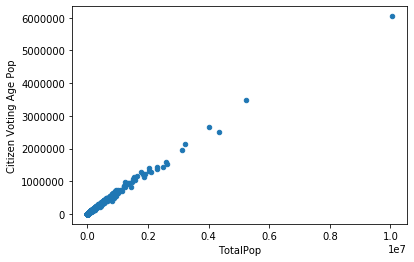

In [44]:
data_new.plot.scatter(x= "TotalPop", y = 'Citizen Voting Age Pop')
r = np.corrcoef(data_new[["TotalPop", "Citizen Voting Age Pop"]].transpose())
r[0,1]**2

In [45]:
X = data_new[["TotalPop", "Citizen Voting Age Pop"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.770
Date:                Mon, 02 Dec 2019   Prob (F-statistic):              0.170
Time:                        19:26:42   Log-Likelihood:                -9107.0
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3217   BIC:                         1.824e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      8

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [46]:
X = data_new[["TotalPop", 'Citizen Voting Age Pop']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.770
Date:                Mon, 02 Dec 2019   Prob (F-statistic):              0.170
Time:                        19:26:42   Log-Likelihood:                -9107.0
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3217   BIC:                         1.824e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                      8

In [47]:
# The vaiables "TotalPop" and "Citizen Voting Age Pop" are not independent. 
# And we got adj R2 value 0 for the combination of "TotalPop" and "Citizen Voting Age Pop" 
# So, we have to include the interaction between these or remove one of them in the regression model

In [48]:
#data_new['TC'] = data_new['TotalPop']*data_new["Citizen Voting Age Pop"]
#removing "Citizen Voting Age Pop"
data_new.drop(['Citizen Voting Age Pop'], axis = 1, inplace = True)

0.9997543986151138

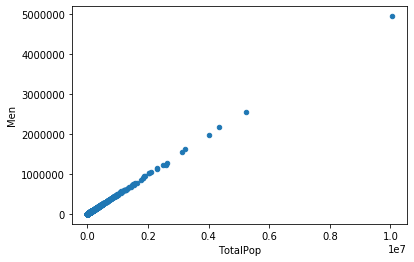

In [49]:
data_new.plot.scatter(x= "TotalPop", y = 'Men')
r = np.corrcoef(data_new[["TotalPop", "Men"]].transpose())
r[0,1]**2

In [50]:
X = data_new[["TotalPop"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.958
Date:                Mon, 02 Dec 2019   Prob (F-statistic):             0.0855
Time:                        19:26:42   Log-Likelihood:                -9107.3
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3218   BIC:                         1.823e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0558      0.076    106.586      0.0

In [51]:
X = data_new[["Men"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.806
Date:                Mon, 02 Dec 2019   Prob (F-statistic):             0.0940
Time:                        19:26:42   Log-Likelihood:                -9107.4
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3218   BIC:                         1.823e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0567      0.076    106.573      0.0

In [52]:
X = data_new[["TotalPop",'Men']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.546
Date:                Mon, 02 Dec 2019   Prob (F-statistic):            0.00394
Time:                        19:26:42   Log-Likelihood:                -9103.3
No. Observations:                3220   AIC:                         1.821e+04
Df Residuals:                    3217   BIC:                         1.823e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0661      0.076    106.718      0.0

In [53]:
#data_new['TM'] = data_new['TotalPop']*data_new["Men"]

In [54]:
# The vaiables "TotalPop" and "Men" are not independent. 
# But the adj R2 value haven't increased significantly with the inclusion of the variable "Men"
# So, we have to keep both for the regression model

In [55]:
#data_new['TM'] = data_new['TotalPop']*data_new["Men"]
#removing "Men"
data_new.drop(["Men"], axis = 1, inplace = True)

0.0396441270817386

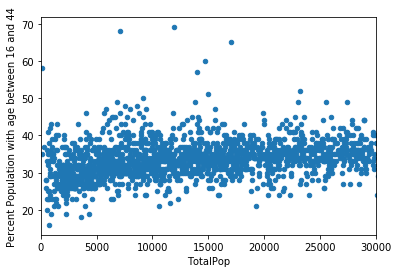

In [56]:
a = data_new.plot.scatter(x= "TotalPop", y= "Percent Population with age between 16 and 44")
a.set(xlim=(0, 30000))
r = np.corrcoef(data_new[["TotalPop", "Percent Population with age between 16 and 44"]].transpose())
r[0,1]**2

0.04331877587595913

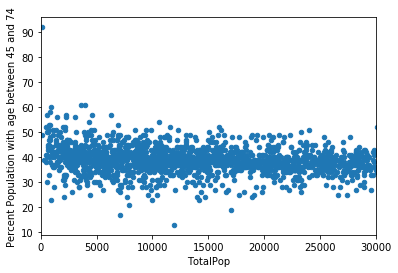

In [57]:
a = data_new.plot.scatter(x= "TotalPop", y= "Percent Population with age between 45 and 74")
a.set(xlim=(0, 30000))
r = np.corrcoef(data_new[["TotalPop", "Percent Population with age between 45 and 74"]].transpose())
r[0,1]**2

0.03287402963861565

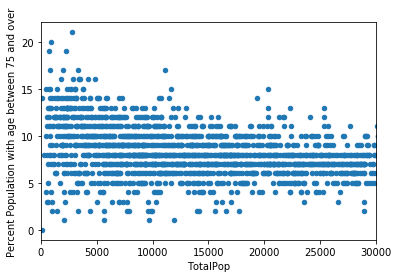

In [58]:
a = data_new.plot.scatter(x= "TotalPop", y= "Percent Population with age between 75 and over")
a.set(xlim=(0, 30000))
r = np.corrcoef(data_new[["TotalPop", "Percent Population with age between 75 and over"]].transpose())
r[0,1]**2


0.580644198059365
0.04602871771139143
0.003180508626417696


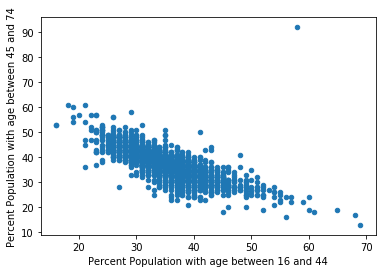

In [59]:
a = data_new.plot.scatter(x= "Percent Population with age between 16 and 44", y= "Percent Population with age between 45 and 74")
a
r1 = np.corrcoef(data_new[["Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74"]].transpose())
print(r1[0,1]**2)

r = np.corrcoef(data_new[["Percent Population with age between 16 and 44", "Unemployment"]].transpose())
print(r[0,1]**2)

r = np.corrcoef(data_new[["Percent Population with age between 45 and 74", "Unemployment"]].transpose())
print(r[0,1]**2)

In [60]:
X = data_new[["Percent Population with age between 16 and 44"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.046
Model:                            OLS   Adj. R-squared:                  0.046
Method:                 Least Squares   F-statistic:                     155.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           7.69e-35
Time:                        19:26:43   Log-Likelihood:                -9032.9
No. Observations:                3220   AIC:                         1.807e+04
Df Residuals:                    3218   BIC:                         1.808e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

In [61]:
X = data_new[["Percent Population with age between 45 and 74"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     10.27
Date:                Mon, 02 Dec 2019   Prob (F-statistic):            0.00137
Time:                        19:26:43   Log-Likelihood:                -9103.7
No. Observations:                3220   AIC:                         1.821e+04
Df Residuals:                    3218   BIC:                         1.822e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

In [62]:
X = data_new[["Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.073
Model:                            OLS   Adj. R-squared:                  0.073
Method:                 Least Squares   F-statistic:                     127.4
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           5.83e-54
Time:                        19:26:44   Log-Likelihood:                -8986.1
No. Observations:                3220   AIC:                         1.798e+04
Df Residuals:                    3217   BIC:                         1.800e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

In [63]:
# The vaiables "Percent Population with age between 16 and 44" and "Percent Population with age between 45 and 74" are not independent. 

# But adj R2 value increased for the combination of "Percent Population with age between 16 and 44" and "Percent Population with age between 45 and 74" 
# So, we have to include both for the regression model

-0.686459373878965
0.2145430439594615
-0.2468141022818537


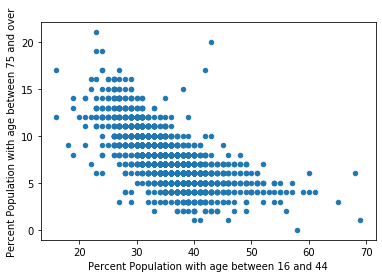

In [64]:
a = data_new.plot.scatter(x= "Percent Population with age between 16 and 44", y= "Percent Population with age between 75 and over")
a
r = np.corrcoef(data_new[["Percent Population with age between 16 and 44", "Percent Population with age between 75 and over"]].transpose())
print(r[0,1])

r = np.corrcoef(data_new[["Percent Population with age between 16 and 44", "Unemployment"]].transpose())
print(r[0,1])

r = np.corrcoef(data_new[["Percent Population with age between 75 and over", "Unemployment"]].transpose())
print(r[0,1])

In [65]:
X = data_new[["Percent Population with age between 75 and over"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.061
Method:                 Least Squares   F-statistic:                     208.7
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           6.83e-46
Time:                        19:26:44   Log-Likelihood:                -9007.6
No. Observations:                3220   AIC:                         1.802e+04
Df Residuals:                    3218   BIC:                         1.803e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                                      coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------

In [66]:
X = data_new[["Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74", "Percent Population with age between 75 and over"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.101
Model:                            OLS   Adj. R-squared:                  0.101
Method:                 Least Squares   F-statistic:                     121.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           2.81e-74
Time:                        19:26:44   Log-Likelihood:                -8936.6
No. Observations:                3220   AIC:                         1.788e+04
Df Residuals:                    3216   BIC:                         1.791e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                                      coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------

In [67]:
# The adj R2 value increased significantly 
# for the combination of "Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74" and "Percent Population with age between 75 and over"
# So, we have to include all the three for the regression model

0.01296915740537312

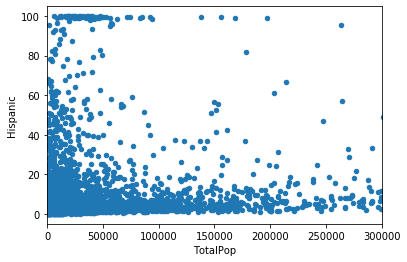

In [68]:
a = data_new.plot.scatter(x= "TotalPop", y = 'Hispanic')
a.set(xlim=(0, 300000))
r = np.corrcoef(data_new[["TotalPop", "Hispanic"]].transpose())
r[0,1]**2

In [69]:
X = data_new[["Hispanic"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.104
Model:                            OLS   Adj. R-squared:                  0.103
Method:                 Least Squares   F-statistic:                     372.2
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           1.45e-78
Time:                        19:26:44   Log-Likelihood:                -8932.6
No. Observations:                3220   AIC:                         1.787e+04
Df Residuals:                    3218   BIC:                         1.788e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.3397      0.079     93.196      0.0

0.03510767886513569

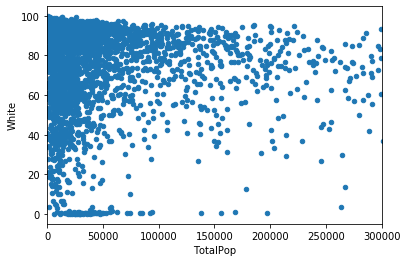

In [70]:
a = data_new.plot.scatter(x= "TotalPop", y = 'White')
a.set(xlim=(0, 300000))
r = np.corrcoef(data_new[["TotalPop", "White"]].transpose())
r[0,1]**2

0.217328492105629

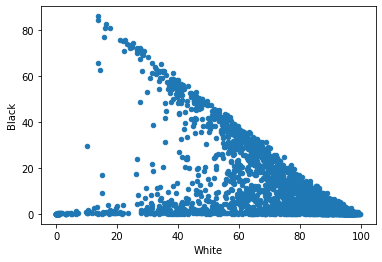

In [71]:
a = data_new.plot.scatter(x= 'White', y = "Black")
a
r = np.corrcoef(data_new[['White', "Black"]].transpose())
r[0,1]**2

In [72]:
X = data_new[['White']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.290
Model:                            OLS   Adj. R-squared:                  0.290
Method:                 Least Squares   F-statistic:                     1317.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          4.38e-242
Time:                        19:26:45   Log-Likelihood:                -8556.4
No. Observations:                3220   AIC:                         1.712e+04
Df Residuals:                    3218   BIC:                         1.713e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.3554      0.209     73.438      0.0

0.009436101892320161

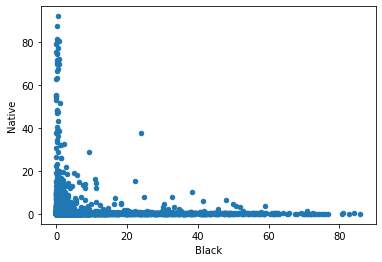

In [73]:
a = data_new.plot.scatter(x= 'Black', y = "Native")
a
r = np.corrcoef(data_new[['Black', "Native"]].transpose())
r[0,1]**2

In [74]:
X = data_new[['Black']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.124
Model:                            OLS   Adj. R-squared:                  0.124
Method:                 Least Squares   F-statistic:                     456.8
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           6.92e-95
Time:                        19:26:45   Log-Likelihood:                -8895.1
No. Observations:                3220   AIC:                         1.779e+04
Df Residuals:                    3218   BIC:                         1.781e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.2180      0.079     91.332      0.0

In [75]:
X = data_new[['Native']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.035
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     118.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           5.07e-27
Time:                        19:26:45   Log-Likelihood:                -9050.8
No. Observations:                3220   AIC:                         1.811e+04
Df Residuals:                    3218   BIC:                         1.812e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.9114      0.073    108.550      0.0

0.0011510539424746322

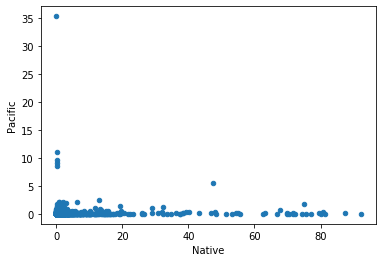

In [76]:
a = data_new.plot.scatter(x= "Native", y = "Pacific")
a
r = np.corrcoef(data_new[["Native", "Pacific"]].transpose())
r[0,1]**2

In [77]:
X = data_new[['Pacific']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     4.647
Date:                Mon, 02 Dec 2019   Prob (F-statistic):             0.0312
Time:                        19:26:45   Log-Likelihood:                -9106.5
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3218   BIC:                         1.823e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.1120      0.073    111.736      0.0

0.12526969897749815

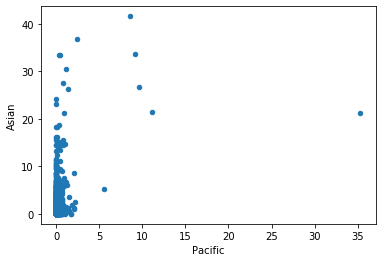

In [78]:
a = data_new.plot.scatter(x= "Pacific", y = "Asian")
a
r = np.corrcoef(data_new[["Pacific", "Asian"]].transpose())
r[0,1]**2

In [79]:
X = data_new[["Asian"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     11.50
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           0.000706
Time:                        19:26:46   Log-Likelihood:                -9103.1
No. Observations:                3220   AIC:                         1.821e+04
Df Residuals:                    3218   BIC:                         1.822e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.2085      0.080    103.208      0.0

0.05517463487086711

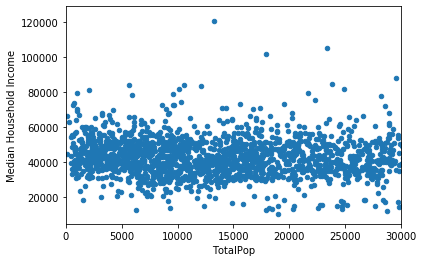

In [80]:
a = data_new.plot.scatter(x= "TotalPop", y= "Median Household Income")
a.set(xlim=(0, 30000))

r = np.corrcoef(data_new[["TotalPop", "Median Household Income"]].transpose())
r[0,1]**2

0.7915135870353791


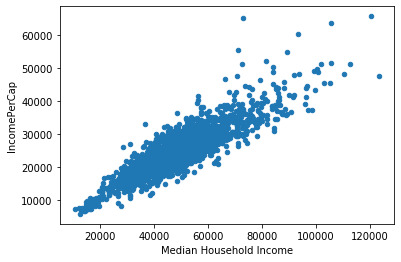

In [81]:
data_new.plot.scatter(x= "Median Household Income", y = 'IncomePerCap')
r = np.corrcoef(data_new[["Median Household Income", 'IncomePerCap']].transpose())
print(r[0,1]**2)


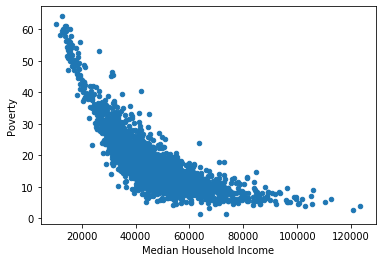

In [82]:
data_new.plot.scatter(x= "Median Household Income", y = 'Poverty')

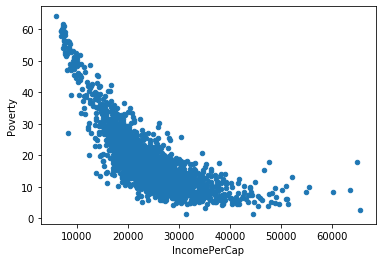

In [83]:
data_new.plot.scatter(x= 'IncomePerCap', y = 'Poverty')

In [84]:
X = data_new[["Median Household Income"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.259
Model:                            OLS   Adj. R-squared:                  0.259
Method:                 Least Squares   F-statistic:                     1127.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          3.81e-212
Time:                        19:26:47   Log-Likelihood:                -8625.3
No. Observations:                3220   AIC:                         1.725e+04
Df Residuals:                    3218   BIC:                         1.727e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [85]:
X = data_new[['IncomePerCap']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.300
Model:                            OLS   Adj. R-squared:                  0.300
Method:                 Least Squares   F-statistic:                     1378.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          2.04e-251
Time:                        19:26:47   Log-Likelihood:                -8534.9
No. Observations:                3220   AIC:                         1.707e+04
Df Residuals:                    3218   BIC:                         1.709e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           16.7644      0.241     69.497   

In [86]:
X = data_new[['Poverty']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     3315.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7968.7
No. Observations:                3220   AIC:                         1.594e+04
Df Residuals:                    3218   BIC:                         1.595e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.9580      0.118     16.591      0.0

In [87]:
X = data_new[['Poverty', 'IncomePerCap']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.508
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     1658.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7968.2
No. Observations:                3220   AIC:                         1.594e+04
Df Residuals:                    3217   BIC:                         1.596e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const            2.3977      0.439      5.458   

In [88]:
X = data_new[['Poverty', "Median Household Income"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.511
Model:                            OLS   Adj. R-squared:                  0.511
Method:                 Least Squares   F-statistic:                     1681.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7956.9
No. Observations:                3220   AIC:                         1.592e+04
Df Residuals:                    3217   BIC:                         1.594e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [89]:
X = data_new[['Poverty', "Median Household Income", 'IncomePerCap']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.518
Model:                            OLS   Adj. R-squared:                  0.518
Method:                 Least Squares   F-statistic:                     1153.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7933.2
No. Observations:                3220   AIC:                         1.587e+04
Df Residuals:                    3216   BIC:                         1.590e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [90]:
# The vaiables 'IncomePerCap' and 'Poverty' are not independent. 
# But the adj R2 value increased significantly 
# with the combination of "Median Household Income" and 'Poverty'
# So, we have to keep both for the regression model

In [91]:
#removing "IncomePerCap"
data_new.drop(["IncomePerCap"], axis = 1, inplace = True)

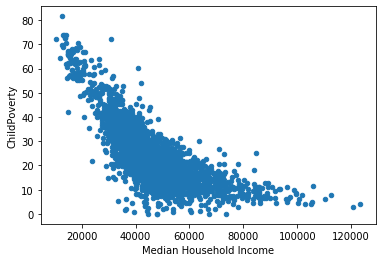

In [92]:
data_new.plot.scatter(x= "Median Household Income", y = "ChildPoverty")

In [93]:
X = data_new[['ChildPoverty']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.457
Model:                            OLS   Adj. R-squared:                  0.457
Method:                 Least Squares   F-statistic:                     2712.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -8124.7
No. Observations:                3220   AIC:                         1.625e+04
Df Residuals:                    3218   BIC:                         1.627e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const            2.3680      0.122     19.386   

In [94]:
X = data_new[['Poverty']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     3315.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7968.7
No. Observations:                3220   AIC:                         1.594e+04
Df Residuals:                    3218   BIC:                         1.595e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.9580      0.118     16.591      0.0

In [95]:
X = data_new[['Poverty', "ChildPoverty"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.509
Model:                            OLS   Adj. R-squared:                  0.508
Method:                 Least Squares   F-statistic:                     1664.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:47   Log-Likelihood:                -7965.1
No. Observations:                3220   AIC:                         1.594e+04
Df Residuals:                    3217   BIC:                         1.595e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const            1.9179      0.119     16.140   

In [96]:
# The vaiables "Poverty" and "ChildPoverty" are not independent. 
# But the adj R2 value haven't increased significantly with the inclusion of 'ChildPoverty'
# So, we have to keep both for the regression model

In [97]:
#data_new['MCP'] = data_new["Median Household Income"]*data_new["ChildPoverty"]
#removing "ChildPoverty"
data_new.drop(["ChildPoverty"], axis = 1, inplace = True)

0.06170419539465504


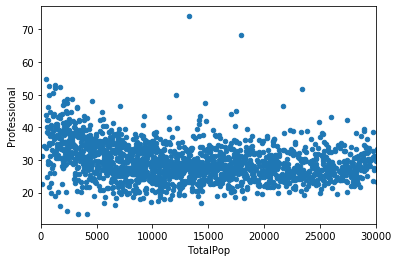

In [98]:
a = data_new.plot.scatter(x= "TotalPop", y = 'Professional')
a.set(xlim=(0, 30000))
r = np.corrcoef(data_new[["TotalPop", 'Professional']].transpose())
print(r[0,1]**2)

0.3368484668658861


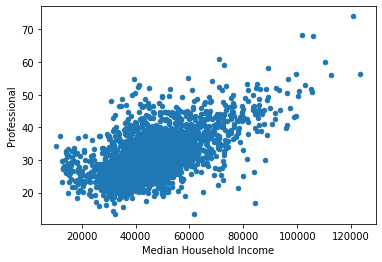

In [99]:
data_new.plot.scatter(x= "Median Household Income", y = 'Professional')
r = np.corrcoef(data_new[["Median Household Income", 'Professional']].transpose())
print(r[0,1]**2)

In [100]:
X = data_new[["Median Household Income"]]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.259
Model:                            OLS   Adj. R-squared:                  0.259
Method:                 Least Squares   F-statistic:                     1127.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          3.81e-212
Time:                        19:26:48   Log-Likelihood:                -8625.3
No. Observations:                3220   AIC:                         1.725e+04
Df Residuals:                    3218   BIC:                         1.727e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [101]:
X = data_new[['Professional']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.090
Model:                            OLS   Adj. R-squared:                  0.090
Method:                 Least Squares   F-statistic:                     319.8
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           2.93e-68
Time:                        19:26:48   Log-Likelihood:                -8956.3
No. Observations:                3220   AIC:                         1.792e+04
Df Residuals:                    3218   BIC:                         1.793e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           14.0873      0.342     41.176   

In [102]:
X = data_new[["Median Household Income",'Professional']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.259
Model:                            OLS   Adj. R-squared:                  0.259
Method:                 Least Squares   F-statistic:                     563.6
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          1.48e-210
Time:                        19:26:48   Log-Likelihood:                -8625.2
No. Observations:                3220   AIC:                         1.726e+04
Df Residuals:                    3217   BIC:                         1.727e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

In [103]:
# The vaiables "Median Household Income" and 'Professional' are not independent. 
# But the R2 value is not increased significantly for the combination of "Median Household Income" and 'Professional' 
# So, we have to include only "Median Household Income" for the the regression model

In [104]:
#removing 'Professional'
data_new.drop(['Professional'], axis = 1, inplace = True)

0.1415837085510463


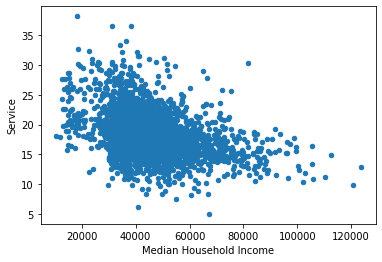

In [105]:
data_new.plot.scatter(x= "Median Household Income", y = 'Service')
r = np.corrcoef(data_new[["Median Household Income", 'Service']].transpose())
print(r[0,1]**2)

In [106]:
X = data_new[['Service']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.133
Model:                            OLS   Adj. R-squared:                  0.133
Method:                 Least Squares   F-statistic:                     493.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):          8.58e-102
Time:                        19:26:48   Log-Likelihood:                -8879.2
No. Observations:                3220   AIC:                         1.776e+04
Df Residuals:                    3218   BIC:                         1.777e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5591      0.346      1.617      0.1

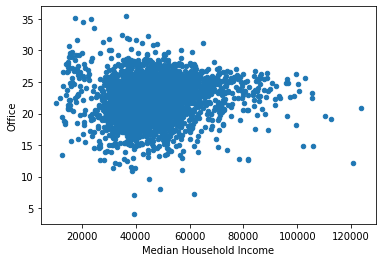

In [107]:
data_new.plot.scatter(x= "Median Household Income", y = 'Office')

In [108]:
X = data_new[['Office']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.026
Model:                            OLS   Adj. R-squared:                  0.026
Method:                 Least Squares   F-statistic:                     87.44
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           1.58e-20
Time:                        19:26:48   Log-Likelihood:                -9065.6
No. Observations:                3220   AIC:                         1.814e+04
Df Residuals:                    3218   BIC:                         1.815e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.4688      0.500      6.941      0.0

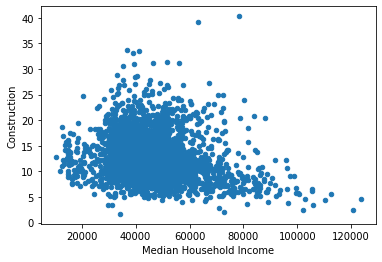

In [109]:
data_new.plot.scatter(x= "Median Household Income", y = 'Construction')

In [110]:
X = data_new[['Construction']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     27.12
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           2.04e-07
Time:                        19:26:48   Log-Likelihood:                -9095.3
No. Observations:                3220   AIC:                         1.819e+04
Df Residuals:                    3218   BIC:                         1.821e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const            9.2234      0.228     40.381   

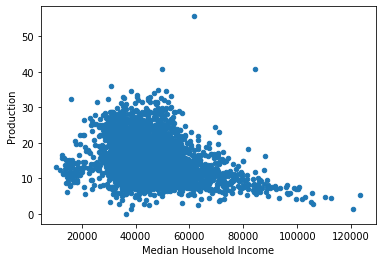

In [111]:
data_new.plot.scatter(x= "Median Household Income", y = 'Production')

In [112]:
X = data_new[['Production']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                  0.006
Method:                 Least Squares   F-statistic:                     20.56
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           6.00e-06
Time:                        19:26:49   Log-Likelihood:                -9098.6
No. Observations:                3220   AIC:                         1.820e+04
Df Residuals:                    3218   BIC:                         1.821e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.1994      0.210     34.262      0.0

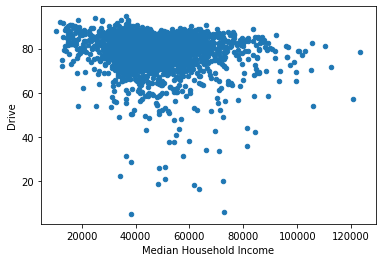

In [113]:
data_new.plot.scatter(x= "Median Household Income", y = 'Drive')

In [114]:
X = data_new[['Drive']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     31.49
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           2.18e-08
Time:                        19:26:49   Log-Likelihood:                -9093.1
No. Observations:                3220   AIC:                         1.819e+04
Df Residuals:                    3218   BIC:                         1.820e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.9254      0.746      5.259      0.0

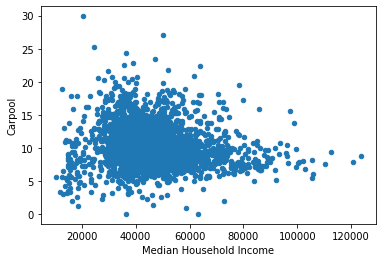

In [115]:
data_new.plot.scatter(x= "Median Household Income", y = 'Carpool')

In [116]:
X = data_new[['Carpool']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     25.64
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           4.36e-07
Time:                        19:26:49   Log-Likelihood:                -9096.0
No. Observations:                3220   AIC:                         1.820e+04
Df Residuals:                    3218   BIC:                         1.821e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.8073      0.264     25.766      0.0

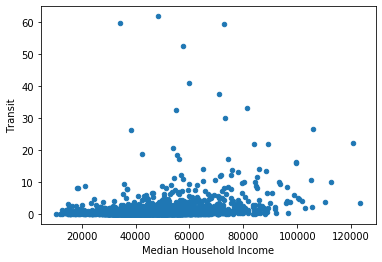

In [117]:
data_new.plot.scatter(x= "Median Household Income", y = 'Transit')

In [118]:
X = data_new[['Transit']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     3.051
Date:                Mon, 02 Dec 2019   Prob (F-statistic):             0.0808
Time:                        19:26:49   Log-Likelihood:                -9107.3
No. Observations:                3220   AIC:                         1.822e+04
Df Residuals:                    3218   BIC:                         1.823e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.0544      0.076    106.375      0.0

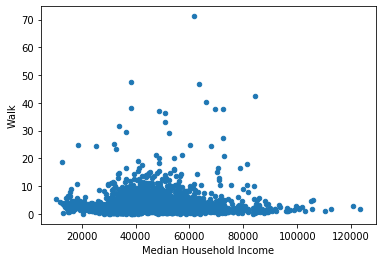

In [119]:
data_new.plot.scatter(x= "Median Household Income", y = 'Walk')

In [120]:
X = data_new[['Walk']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     23.04
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           1.66e-06
Time:                        19:26:50   Log-Likelihood:                -9097.3
No. Observations:                3220   AIC:                         1.820e+04
Df Residuals:                    3218   BIC:                         1.821e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.4000      0.096     87.443      0.0

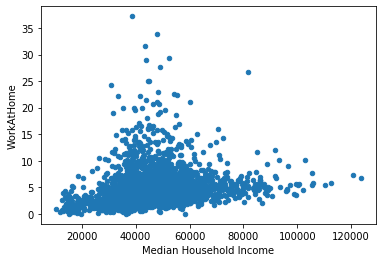

In [121]:
data_new.plot.scatter(x= "Median Household Income", y = 'WorkAtHome')

In [122]:
X = data_new[['WorkAtHome']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.094
Model:                            OLS   Adj. R-squared:                  0.094
Method:                 Least Squares   F-statistic:                     333.8
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           5.03e-71
Time:                        19:26:50   Log-Likelihood:                -8949.9
No. Observations:                3220   AIC:                         1.790e+04
Df Residuals:                    3218   BIC:                         1.792e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.9240      0.121     81.708      0.0

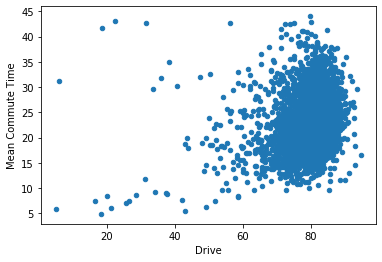

In [123]:
data_new.plot.scatter(x= "Drive", y = 'Mean Commute Time')

In [124]:
X = data_new[['Mean Commute Time']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.086
Model:                            OLS   Adj. R-squared:                  0.086
Method:                 Least Squares   F-statistic:                     303.8
Date:                Mon, 02 Dec 2019   Prob (F-statistic):           4.28e-65
Time:                        19:26:50   Log-Likelihood:                -8963.5
No. Observations:                3220   AIC:                         1.793e+04
Df Residuals:                    3218   BIC:                         1.794e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 3.0935      0.29

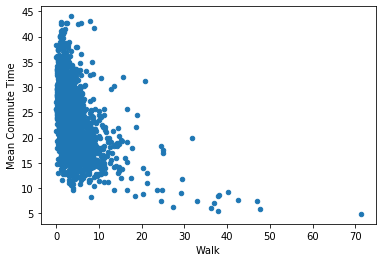

In [125]:
data_new.plot.scatter(x= "Walk", y = 'Mean Commute Time')

[(0, 30000)]

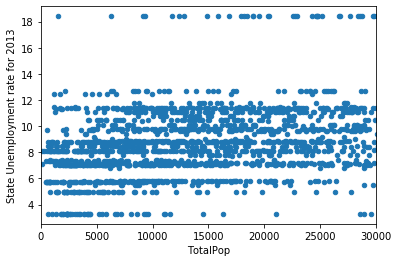

In [126]:
a = data_new.plot.scatter(x= 'TotalPop', y = 'State Unemployment rate for 2013')
a.set(xlim=(0, 30000))

In [127]:
X = data_new[['State Unemployment rate for 2013']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.409
Model:                            OLS   Adj. R-squared:                  0.409
Method:                 Least Squares   F-statistic:                     2229.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:51   Log-Likelihood:                -8261.4
No. Observations:                3220   AIC:                         1.653e+04
Df Residuals:                    3218   BIC:                         1.654e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

[(0, 30000)]

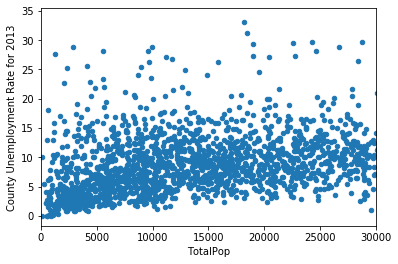

In [128]:
a = data_new.plot.scatter(x= 'TotalPop', y = 'County Unemployment Rate for 2013')
a.set(xlim=(0, 30000))

In [129]:
X = data_new[['County Unemployment Rate for 2013']]
Y = data_new["Unemployment"]
X = sm.add_constant(X)
results3 = sm.OLS(Y,X).fit()
print(results3.summary())
#SSE = round(results3.ssr,3)
#SSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.800
Model:                            OLS   Adj. R-squared:                  0.800
Method:                 Least Squares   F-statistic:                 1.288e+04
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:26:51   Log-Likelihood:                -6516.5
No. Observations:                3220   AIC:                         1.304e+04
Df Residuals:                    3218   BIC:                         1.305e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const 

In [130]:
data_new.to_csv('Regression.csv')

In [131]:
data_new.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [132]:
# THe attributes 'County Unemployment Rate for 2013', 'State Unemployment rate for 2013', 'Poverty', 
# 'White', "Median Household Income", 'Black', and 'Service' are important variables for regression

In [133]:
# The Original New dataset
data_new  = pd.read_csv('New.csv')
data_new.drop(['Unnamed: 0'], axis = 1, inplace = True)
data_new.drop(['IncomeErr', 'IncomePerCapErr'], axis = 1, inplace = True)

In [134]:
data_new.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

        count           mean            std     min       25%      50%  \
Class                                                                    
1      1756.0   88028.545558  249871.090268    85.0   8606.00  22067.0   
2      1044.0  129183.262452  434021.122418  1071.0  17056.50  34032.5   
3       420.0   72982.480952  222274.969707   117.0  11712.25  22750.5   

            75%         max  
Class                        
1      62192.75   4356362.0  
2      86261.75  10038388.0  
3      46931.75   2298032.0  
[(0, 300000)]


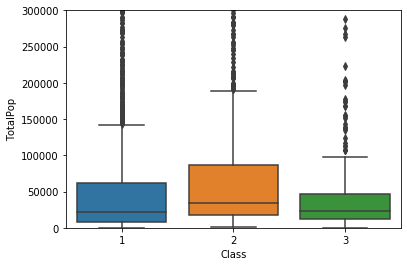

In [135]:
#data3 = data_new.drop(['StateId','CensusId', 'State', 'County'], axis=1)
#print(data3.groupby("Class").describe())

print(data_new.groupby("Class").describe()["TotalPop"])
t = sns.boxplot(x = data_new["Class"], y = data_new['TotalPop'], data = data_new)
#plt.ylim(0, 6000000)
print(t.set(ylim=(0, 300000)))


        count       mean       std   min   25%   50%   75%   max
Class                                                           
1      1756.0  34.561503  5.107302  16.0  31.0  34.0  37.0  68.0
2      1044.0  35.695402  4.825342  16.0  33.0  35.0  38.0  65.0
3       420.0  36.445238  5.340828  19.0  34.0  37.0  40.0  69.0
AxesSubplot(0.125,0.125;0.775x0.755)


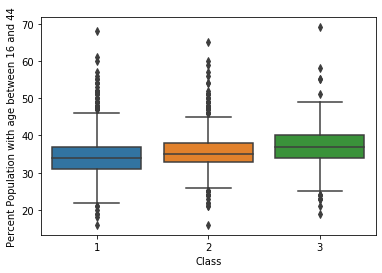

In [136]:
print(data_new.groupby("Class").describe()["Percent Population with age between 16 and 44"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Percent Population with age between 16 and 44'], data = data_new)
print(t)

        count       mean       std   min   25%   50%   75%   max
Class                                                           
1      1756.0  37.363326  5.167739  17.0  34.0  38.0  40.0  61.0
2      1044.0  37.364943  4.854149  16.0  35.0  37.5  40.0  61.0
3       420.0  37.242857  6.353401  13.0  34.0  37.0  40.0  92.0
AxesSubplot(0.125,0.125;0.775x0.755)


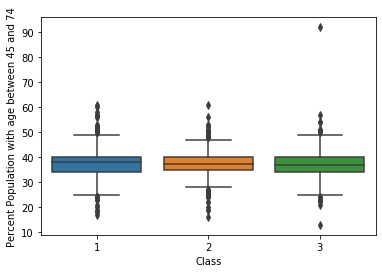

In [137]:
print(data_new.groupby("Class").describe()["Percent Population with age between 45 and 74"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Percent Population with age between 45 and 74'], data = data_new)
print(t)

        count      mean       std  min  25%  50%  75%   max
Class                                                      
1      1756.0  7.878132  2.667513  1.0  6.0  8.0  9.0  21.0
2      1044.0  7.159004  1.910160  1.0  6.0  7.0  8.0  17.0
3       420.0  6.985714  2.301766  0.0  6.0  7.0  8.0  17.0
AxesSubplot(0.125,0.125;0.775x0.755)


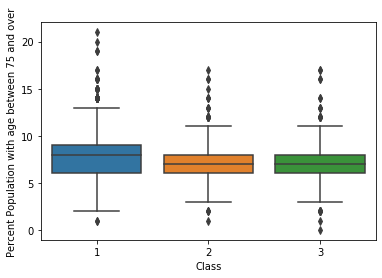

In [138]:
print(data_new.groupby("Class").describe()["Percent Population with age between 75 and over"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Percent Population with age between 75 and over'], data = data_new)
print(t)

        count          mean            std    min      25%      50%       75%  \
Class                                                                           
1      1756.0  43459.414009  123101.325991   42.0  4374.75  11085.5  30830.00   
2      1044.0  63335.814176  212590.189113  520.0  8527.25  16801.5  41808.00   
3       420.0  35740.045238  108668.577080   74.0  5773.00  11118.5  22897.25   

             max  
Class             
1      2166727.0  
2      4945351.0  
3      1143477.0  
[(0, 100000)]


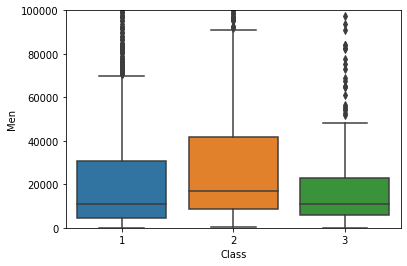

In [139]:
print(data_new.groupby("Class").describe()["Men"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Men'], data = data_new)
print(t.set(ylim=(0, 100000)))

        count          mean            std    min      25%      50%       75%  \
Class                                                                           
1      1756.0  44569.131549  126797.367775   43.0  4232.75  10936.5  31251.75   
2      1044.0  65847.448276  221470.784147  446.0  8617.50  17118.5  44197.50   
3       420.0  37242.435714  113683.921658   43.0  5723.00  11698.0  23926.25   

             max  
Class             
1      2189635.0  
2      5093037.0  
3      1154555.0  
[(0, 100000)]


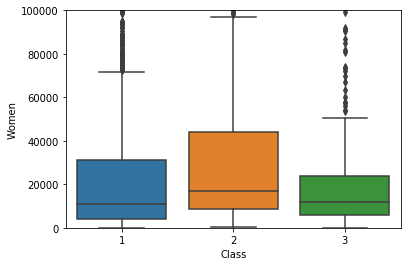

In [140]:
print(data_new.groupby("Class").describe()["Women"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Women'], data = data_new)
print(t.set(ylim=(0, 100000)))

        count       mean        std  min  25%   50%     75%   max
Class                                                            
1      1756.0   8.979043  13.601953  0.0  1.9  3.90   9.200  99.9
2      1044.0   9.134483  14.567546  0.0  2.0  3.80   9.025  99.9
3       420.0  24.175000  36.624501  0.1  1.8  4.05  24.300  99.9
AxesSubplot(0.125,0.125;0.775x0.755)


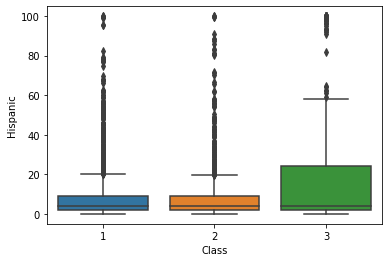

In [141]:
print(data_new.groupby("Class").describe()["Hispanic"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Hispanic'], data = data_new)
print(t)

        count       mean        std  min     25%   50%     75%   max
Class                                                               
1      1756.0  82.198804  16.680029  0.0  75.300  88.6  94.300  99.8
2      1044.0  74.589464  19.613432  0.0  62.500  78.9  91.600  99.3
3       420.0  49.210000  32.164598  0.0  24.075  51.1  74.925  99.6
AxesSubplot(0.125,0.125;0.775x0.755)


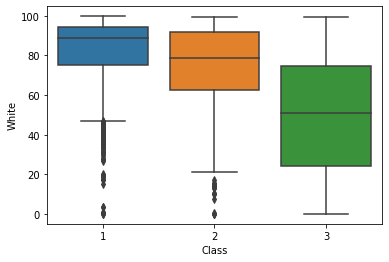

In [142]:
print(data_new.groupby("Class").describe()["White"])
t = sns.boxplot(x = data_new["Class"], y = data_new['White'], data = data_new)
print(t)

        count       mean        std  min  25%  50%     75%   max
Class                                                           
1      1756.0   4.310535   7.684730  0.0  0.4  1.2   4.400  60.9
2      1044.0  11.727969  14.611252  0.0  1.0  4.7  18.100  70.7
3       420.0  19.260952  23.921925  0.0  0.3  3.5  37.325  85.9
AxesSubplot(0.125,0.125;0.775x0.755)


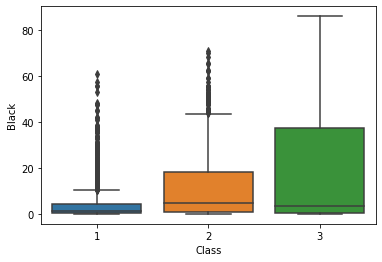

In [143]:
print(data_new.groupby("Class").describe()["Black"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Black'], data = data_new)
print(t)

        count      mean        std  min  25%  50%  75%   max
Class                                                       
1      1756.0  1.203986   4.103558  0.0  0.1  0.3  0.6  77.2
2      1044.0  1.286303   4.474761  0.0  0.1  0.3  0.6  67.6
3       420.0  4.982381  16.478295  0.0  0.0  0.2  0.7  92.1
[(0, 5)]


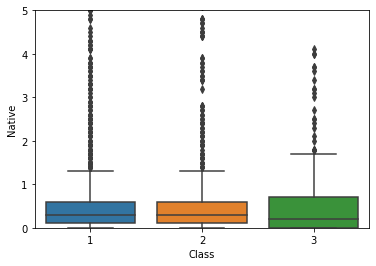

In [144]:
print(data_new.groupby("Class").describe()["Native"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Native'], data = data_new)
#print(t)
print(t.set(ylim=(0, 5)))

        count      mean       std  min  25%  50%    75%   max
Class                                                        
1      1756.0  1.370103  3.071275  0.0  0.2  0.5  1.200  41.6
2      1044.0  1.177395  2.110251  0.0  0.3  0.6  1.225  27.5
3       420.0  0.767857  1.538306  0.0  0.0  0.3  0.800  14.6
[(0, 5)]


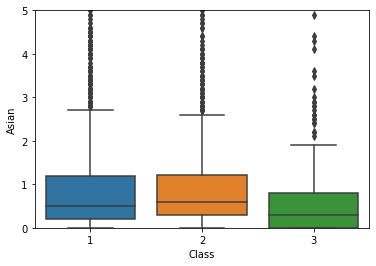

In [145]:
print(data_new.groupby("Class").describe()["Asian"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Asian'], data = data_new)
#print(t)
print(t.set(ylim=(0, 5)))

        count      mean       std  min  25%  50%  75%   max
Class                                                      
1      1756.0  0.092426  0.939840  0.0  0.0  0.0  0.0  35.3
2      1044.0  0.079023  0.414422  0.0  0.0  0.0  0.1  11.1
3       420.0  0.051429  0.144503  0.0  0.0  0.0  0.0   1.7
[(0, 5)]


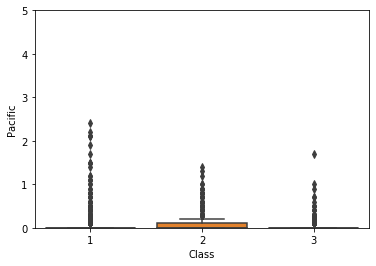

In [146]:
print(data_new.groupby("Class").describe()["Pacific"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Pacific'], data = data_new)
#print(t)
print(t.set(ylim=(0, 5)))

        count          mean            std    min       25%      50%      75%  \
Class                                                                           
1      1756.0  62344.400911  164071.358625   80.0   6517.25  16188.5  46760.0   
2      1044.0  90527.847701  274918.216913  855.0  13153.00  25607.5  63102.0   
3       420.0  50483.547619  143757.199857   98.0   8904.50  16946.0  34696.5   

             max  
Class             
1      2659853.0  
2      6046749.0  
3      1427761.0  
[(0, 400000)]


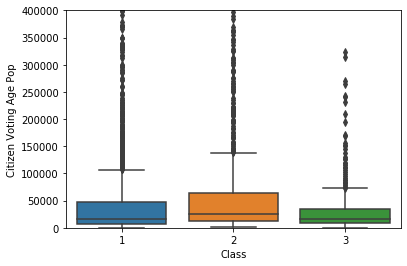

In [147]:
print(data_new.groupby("Class").describe()["Citizen Voting Age Pop"])
t = sns.boxplot(x = data_new["Class"], y = data_new['Citizen Voting Age Pop'], data = data_new)
#print(t)
print(t.set(ylim=(0, 400000)))

        count          mean           std      min       25%      50%  \
Class                                                                   
1      1756.0  51156.911731  12566.900166  13944.0  43242.75  49095.0   
2      1044.0  42943.704023   9312.462095  12606.0  36614.00  41622.0   
3       420.0  33028.650000   9984.566826  10499.0  27453.00  33011.5   

           75%       max  
Class                     
1      56034.5  123453.0  
2      47914.0   86565.0  
3      39453.0   78190.0  
AxesSubplot(0.125,0.125;0.775x0.755)


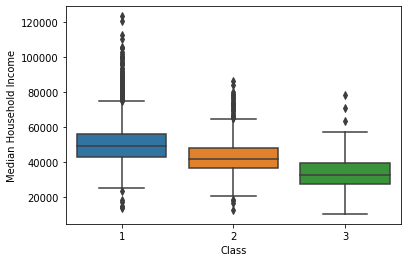

In [148]:
print(data_new.groupby("Class").describe()["Median Household Income"])
t = sns.boxplot(x = data_new["Class"], y = data_new["Median Household Income"], data = data_new)
print(t)

        count          mean          std     min       25%      50%       75%  \
Class                                                                           
1      1756.0  26390.328588  5972.005143  6792.0  22766.75  25667.5  28947.50   
2      1044.0  22538.493295  4509.488239  5878.0  19691.00  21780.0  24549.25   
3       420.0  17499.288095  4909.425435  6774.0  14740.50  18130.0  20659.00   

           max  
Class           
1      65600.0  
2      51085.0  
3      32708.0  
AxesSubplot(0.125,0.125;0.775x0.755)


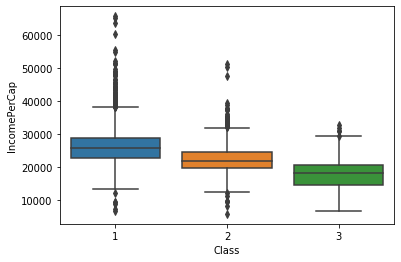

In [149]:
print(data_new.groupby("Class").describe()["IncomePerCap"])
t = sns.boxplot(x = data_new["Class"], y = data_new["IncomePerCap"], data = data_new)
print(t)

        count       mean        std  min   25%    50%     75%   max
Class                                                              
1      1756.0  13.813212   5.412025  1.4  10.2  13.10  16.500  61.2
2      1044.0  19.046456   5.640315  5.7  15.6  18.40  21.625  64.2
3       420.0  29.018571  11.564803  4.9  20.7  26.25  34.125  61.7
AxesSubplot(0.125,0.125;0.775x0.755)


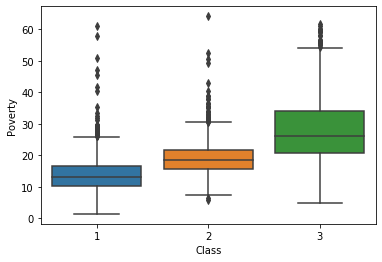

In [150]:
print(data_new.groupby("Class").describe()['Poverty'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Poverty'], data = data_new)
print(t)

        count       mean        std  min     25%   50%    75%   max
Class                                                              
1      1756.0  18.810364   8.605790  0.0  12.700  17.9  23.70  74.0
2      1044.0  27.097797   8.432854  1.4  21.700  26.3  31.60  81.6
3       420.0  39.380000  13.790733  0.0  29.975  36.9  47.95  73.8
AxesSubplot(0.125,0.125;0.775x0.755)


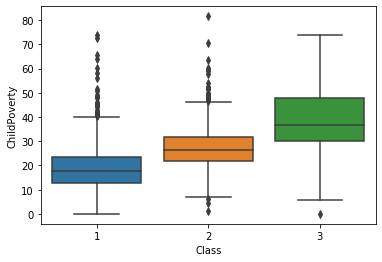

In [151]:
print(data_new.groupby("Class").describe()['ChildPoverty'])
t = sns.boxplot(x = data_new["Class"], y = data_new['ChildPoverty'], data = data_new)
print(t)

        count       mean       std   min     25%   50%   75%   max
Class                                                             
1      1756.0  32.688610  6.755260  13.6  28.175  31.7  36.2  74.0
2      1044.0  29.463793  5.098500  14.5  26.000  28.8  32.3  60.9
3       420.0  27.686667  5.186232  13.5  24.075  27.1  30.1  48.7
AxesSubplot(0.125,0.125;0.775x0.755)


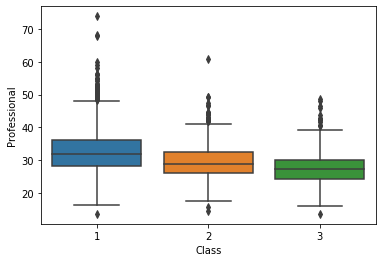

In [152]:
print(data_new.groupby("Class").describe()['Professional'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Professional'], data = data_new)
print(t)

        count       mean       std   min   25%   50%   75%   max
Class                                                           
1      1756.0  17.381321  3.298447   5.0  15.3  17.1  19.2  34.1
2      1044.0  18.981226  3.308404  10.9  16.8  18.8  21.0  32.2
3       420.0  20.803333  4.216548   9.9  18.1  20.4  23.1  38.2
AxesSubplot(0.125,0.125;0.775x0.755)


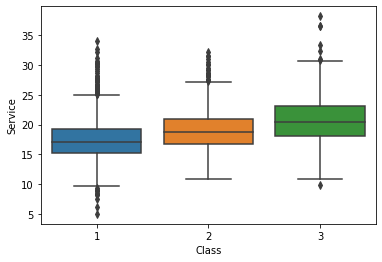

In [153]:
print(data_new.groupby("Class").describe()['Service'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Service'], data = data_new)
print(t)

        count       mean       std   min     25%   50%   75%   max
Class                                                             
1      1756.0  21.890433  3.145005   4.1  19.900  22.1  24.2  31.1
2      1044.0  22.585728  3.002712   7.1  20.800  22.9  24.6  35.4
3       420.0  22.656667  3.715038  11.6  20.375  22.5  24.9  35.2
AxesSubplot(0.125,0.125;0.775x0.755)


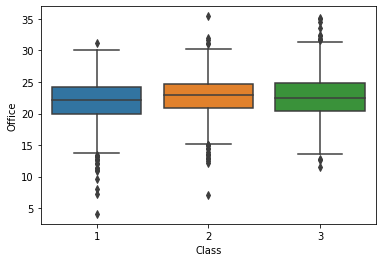

In [154]:
print(data_new.groupby("Class").describe()['Office'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Office'], data = data_new)
print(t)

        count       mean       std  min   25%    50%   75%   max
Class                                                           
1      1756.0  12.841344  4.318372  1.7   9.9  12.40  15.1  39.2
2      1044.0  12.459770  4.108284  2.9   9.7  11.85  14.6  33.7
3       420.0  12.814286  4.030354  3.5  10.1  12.20  14.9  40.3
AxesSubplot(0.125,0.125;0.775x0.755)


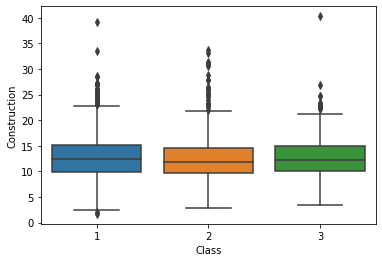

In [155]:
print(data_new.groupby("Class").describe()['Construction'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Construction'], data = data_new)
print(t)

        count       mean       std  min   25%   50%   75%   max
Class                                                          
1      1756.0  15.196925  5.736232  0.0  11.0  14.8  18.7  55.6
2      1044.0  16.511590  5.644557  2.4  12.3  16.2  20.4  34.5
3       420.0  16.041905  5.731907  1.3  11.6  15.2  19.9  35.9
AxesSubplot(0.125,0.125;0.775x0.755)


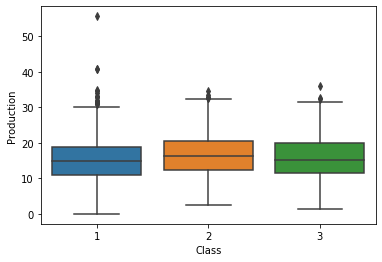

In [156]:
print(data_new.groupby("Class").describe()['Production'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Production'], data = data_new)
print(t)

        count       mean        std   min   25%   50%   75%   max
Class                                                            
1      1756.0  78.564066   7.285580   6.1  75.9  80.0  83.1  94.6
2      1044.0  80.320019   6.695111  18.6  78.0  81.6  84.3  92.9
3       420.0  78.936190  10.571047   5.2  76.9  81.2  84.6  93.6
AxesSubplot(0.125,0.125;0.775x0.755)


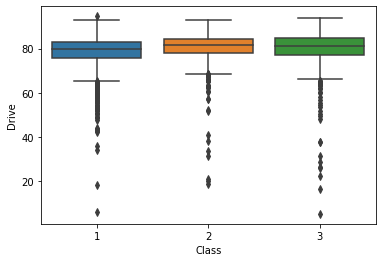

In [157]:
print(data_new.groupby("Class").describe()['Drive'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Drive'], data = data_new)
print(t)

        count       mean       std  min  25%   50%   75%   max
Class                                                         
1      1756.0   9.995672  2.793657  0.0  8.2   9.6  11.5  27.0
2      1044.0  10.509004  2.730523  2.0  8.7  10.1  12.0  25.3
3       420.0  10.890000  3.587687  1.2  8.6  10.6  13.1  29.9
AxesSubplot(0.125,0.125;0.775x0.755)


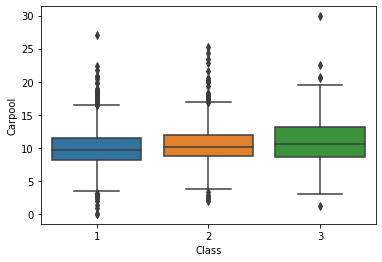

In [158]:
print(data_new.groupby("Class").describe()['Carpool'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Carpool'], data = data_new)
print(t)

        count      mean       std  min  25%  50%  75%   max
Class                                                      
1      1756.0  0.923235  2.591744  0.0  0.1  0.3  0.8  59.2
2      1044.0  1.017625  3.491693  0.0  0.2  0.4  0.8  61.7
3       420.0  1.061190  3.658344  0.0  0.1  0.4  0.9  59.7
[(0, 5)]


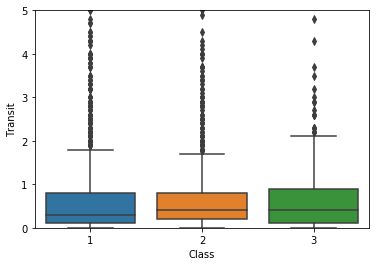

In [159]:
print(data_new.groupby("Class").describe()['Transit'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Transit'], data = data_new)
print(t.set(ylim=(0, 5)))

        count      mean       std  min  25%  50%  75%   max
Class                                                      
1      1756.0  3.698861  3.831263  0.0  1.6  2.8  4.5  71.2
2      1044.0  2.634866  2.712662  0.0  1.2  2.0  3.2  37.9
3       420.0  3.465952  5.176504  0.1  1.4  2.2  3.6  47.6
[(0, 10)]


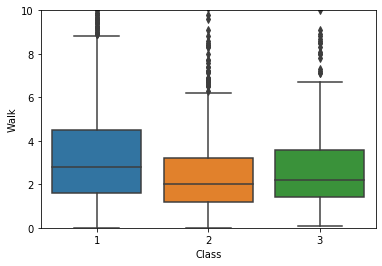

In [160]:
print(data_new.groupby("Class").describe()['Walk'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Walk'], data = data_new)
print(t.set(ylim=(0, 10)))

        count      mean       std  min    25%  50%  75%   max
Class                                                        
1      1756.0  5.323861  3.434666  0.0  3.300  4.6  6.3  37.2
2      1044.0  3.862261  2.084360  0.2  2.500  3.4  4.8  20.0
3       420.0  3.650952  3.599373  0.0  1.775  2.8  4.4  33.9
[(0, 15)]


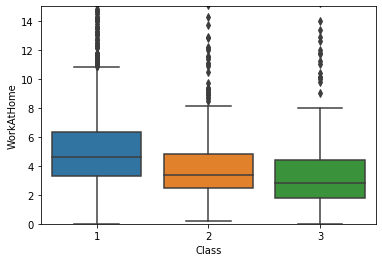

In [161]:
print(data_new.groupby("Class").describe()['WorkAtHome'])
t = sns.boxplot(x = data_new["Class"], y = data_new['WorkAtHome'], data = data_new)
print(t.set(ylim=(0, 15)))

        count       mean       std  min   25%   50%     75%   max
Class                                                            
1      1756.0  22.037130  5.509241  4.9  18.1  21.8  25.400  42.8
2      1044.0  24.592816  5.041819  6.0  21.1  24.2  27.925  44.0
3       420.0  25.203571  6.006843  5.9  21.3  24.9  29.100  43.0
AxesSubplot(0.125,0.125;0.775x0.755)


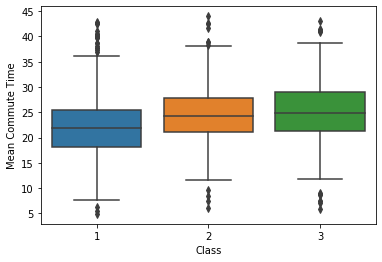

In [162]:
print(data_new.groupby("Class").describe()['Mean Commute Time'])
t = sns.boxplot(x = data_new["Class"], y = data_new['Mean Commute Time'], data = data_new)
print(t)

        count       mean       std  min  25%   50%   75%   max
Class                                                         
1      1756.0   8.045843  1.956740  3.3  7.0   8.1   9.2  18.4
2      1044.0   9.935632  1.607537  5.7  8.8  10.0  11.1  18.4
3       420.0  11.602381  3.348635  3.3  9.8  11.1  11.5  18.4
AxesSubplot(0.125,0.125;0.775x0.755)


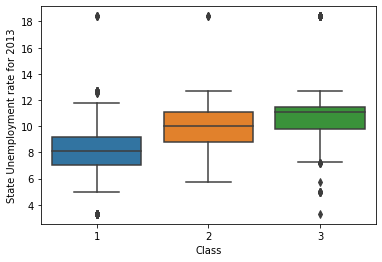

In [163]:
print(data_new.groupby("Class").describe()['State Unemployment rate for 2013'])
t = sns.boxplot(x = data_new["Class"], y = data_new['State Unemployment rate for 2013'], data = data_new)
print(t)

        count       mean       std  min     25%   50%   75%   max
Class                                                            
1      1756.0   6.583770  2.394765  0.0   5.100   6.8   8.3  25.2
2      1044.0  11.040326  2.173847  4.1   9.700  10.9  12.2  28.1
3       420.0  16.123810  4.510148  2.4  13.375  15.4  17.7  33.7
AxesSubplot(0.125,0.125;0.775x0.755)


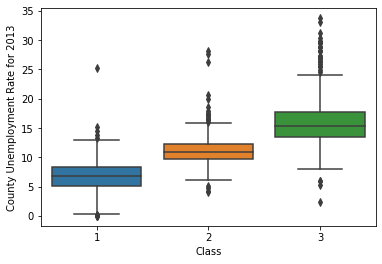

In [164]:
print(data_new.groupby("Class").describe()['County Unemployment Rate for 2013'])
t = sns.boxplot(x = data_new["Class"], y = data_new['County Unemployment Rate for 2013'], data = data_new)
print(t)

In [165]:
data_new.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [166]:
data_new.to_csv("Classification.csv")

In [167]:
#The variables 'TotalPop', 'Men;, White', 'Black','Citizen Voting Age Pop', 'Median Household Income', 
#               'IncomePerCap', 'Poverty', 'ChildPoverty', 'County Unemployment Rate for 2013' 
#                are the important attributes to determine the class of a county

In [168]:
data_new['Class'][data_new['Class'] == 1] = "Lowest"
data_new['Class'][data_new['Class'] == 2] = "Moderate"
data_new['Class'][data_new['Class'] == 3] = "Highest"

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [169]:
# Regression Model

dataR = pd.read_csv("Regression.csv")
dataR.head()

,Unnamed: 0,StateId,CensusId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Hispanic,...,Drive,Carpool,Transit,Walk,WorkAtHome,Mean Commute Time,State Unemployment rate for 2013,County Unemployment Rate for 2013,Unemployment,Class
0,0,1,1001,Alabama,Autauga,55221,38.0,34.0,5.0,2.6,...,87.5,8.8,0.1,0.5,1.8,26.5,10.8,9.4,7.6,1
1,1,1,1003,Alabama,Baldwin,195121,33.0,37.0,7.0,4.5,...,84.7,8.8,0.1,1.0,3.9,26.4,10.8,9.2,7.5,1
2,2,1,1005,Alabama,Barbour,26932,39.0,38.0,7.0,4.6,...,83.8,10.9,0.4,1.8,1.6,24.1,10.8,14.3,17.6,3
3,3,1,1007,Alabama,Bibb,22604,41.0,35.0,6.0,2.2,...,83.2,13.5,0.5,0.6,0.7,28.8,10.8,12.2,8.3,2
4,4,1,1009,Alabama,Blount,57710,36.0,37.0,6.0,8.6,...,84.9,11.2,0.4,0.9,2.3,34.9,10.8,9.7,7.7,1


In [170]:
dataR.columns

Index(['Unnamed: 0', 'StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [171]:
dataR.drop("Unnamed: 0", axis = 1 , inplace = True)

In [172]:
dataR.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 30 columns):
StateId                                            3220 non-null int64
CensusId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Percent Population with age between 16 and 44      3220 non-null float64
Percent Population with age between 45 and 74      3220 non-null float64
Percent Population with age between 75 and over    3220 non-null float64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                                             3220 non-null float64
Asian                    

In [173]:
# TASK 1
X_train, X_val= train_test_split(dataR, test_size = 0.2, random_state = 1)
x_train = X_train.iloc[:,4:28]
x_val =   X_val.iloc[:,4:28]                                             
y_train = X_train.iloc[:,28:29]
y_val = X_val.iloc[:,28:29]


In [174]:
# TASK 1
"""X_train, X_test= train_test_split(dataR, test_size = 0.2, random_state = 1)
X_train, X_val= train_test_split(X_train, test_size = 0.2, random_state = 1)
x_train = X_train.iloc[:,4:28]
x_val =   X_val.iloc[:,4:28]                                             
y_train = X_train.iloc[:,28:29]
y_val = X_val.iloc[:,28:29]
x_test = X_test.iloc[:,4:28]
y_test = X_test.iloc[:,28:29]

x_val.info()"""

'X_train, X_test= train_test_split(dataR, test_size = 0.2, random_state = 1)\nX_train, X_val= train_test_split(X_train, test_size = 0.2, random_state = 1)\nx_train = X_train.iloc[:,4:28]\nx_val =   X_val.iloc[:,4:28]                                             \ny_train = X_train.iloc[:,28:29]\ny_val = X_val.iloc[:,28:29]\nx_test = X_test.iloc[:,4:28]\ny_test = X_test.iloc[:,28:29]\n\nx_val.info()'

In [175]:
#x_train.info()
#y_train.info()
x_train.columns

Index(['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013'],
      dtype='object')

In [176]:
scaler = MinMaxScaler(feature_range=(0, 1))
x_train[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013']] = scaler.fit_transform(x_train[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013']])

x_val[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013']] = scaler.fit_transform(x_val[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013',
       'County Unemployment Rate for 2013']])

In [177]:
x_train.head()

,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Hispanic,White,Black,Native,Asian,Pacific,...,Construction,Production,Drive,Carpool,Transit,Walk,WorkAtHome,Mean Commute Time,State Unemployment rate for 2013,County Unemployment Rate for 2013
2024,0.000429,0.283019,0.354430,0.619048,0.011011,0.958918,0.005821,0.020630,0.000000,0.000000,...,0.432642,0.185252,0.814689,0.197324,0.043551,0.115169,0.131720,0.232737,0.000000,0.056380
2128,0.003716,0.358491,0.316456,0.380952,0.040040,0.934870,0.012806,0.002172,0.010870,0.005666,...,0.204663,0.568345,0.917514,0.234114,0.001675,0.023876,0.059140,0.363171,0.443709,0.353116
2762,0.026216,0.471698,0.126582,0.142857,0.953954,0.037074,0.003492,0.001086,0.016304,0.000000,...,0.225389,0.226619,0.827119,0.474916,0.020101,0.021067,0.083333,0.429668,0.317881,0.204748
3132,0.000242,0.377358,0.316456,0.476190,0.026026,0.916834,0.003492,0.018458,0.016304,0.000000,...,0.238342,0.224820,0.666667,0.264214,0.008375,0.169944,0.311828,0.314578,0.145695,0.112760
1399,0.012812,0.396226,0.227848,0.190476,0.027027,0.932866,0.011641,0.004343,0.027174,0.000000,...,0.251295,0.269784,0.872316,0.274247,0.013400,0.019663,0.129032,0.652174,0.251656,0.201780


In [178]:

# Build model with 1 predictor (using statsmodels)
X = x_train["Poverty"] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.503
Model:                            OLS   Adj. R-squared:                  0.503
Method:                 Least Squares   F-statistic:                     2604.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6362.7
No. Observations:                2576   AIC:                         1.273e+04
Df Residuals:                    2574   BIC:                         1.274e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.5757      0.122     21.147      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.634216106956256

In [179]:

# Build model with 2 predictors (using statsmodels)
X = x_train[["Poverty", 'White']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.519
Model:                            OLS   Adj. R-squared:                  0.519
Method:                 Least Squares   F-statistic:                     1388.
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6320.4
No. Observations:                2576   AIC:                         1.265e+04
Df Residuals:                    2573   BIC:                         1.266e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.4832      0.336     16.315      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.349700624803543

In [180]:

# Build model with 3 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Median Household Income"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Median Household Income"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.519
Model:                            OLS   Adj. R-squared:                  0.518
Method:                 Least Squares   F-statistic:                     924.9
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6320.4
No. Observations:                2576   AIC:                         1.265e+04
Df Residuals:                    2572   BIC:                         1.267e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
const                     

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.353247365549857

In [181]:

# Build model with 3 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.530
Model:                            OLS   Adj. R-squared:                  0.530
Method:                 Least Squares   F-statistic:                     967.9
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6289.7
No. Observations:                2576   AIC:                         1.259e+04
Df Residuals:                    2572   BIC:                         1.261e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.5063      0.355     12.710      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.248280983332641

In [182]:

# Build model with 3 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.538
Model:                            OLS   Adj. R-squared:                  0.537
Method:                 Least Squares   F-statistic:                     748.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6268.5
No. Observations:                2576   AIC:                         1.255e+04
Df Residuals:                    2571   BIC:                         1.258e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.3333      0.395      8.441      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.267362291887954

In [183]:

# Build model with 4 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.547
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     620.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6243.8
No. Observations:                2576   AIC:                         1.250e+04
Df Residuals:                    2570   BIC:                         1.253e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.1356      0.407     10.151      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.12280502874681

In [184]:

# Build model with 5 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.557
Model:                            OLS   Adj. R-squared:                  0.556
Method:                 Least Squares   F-statistic:                     538.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6214.3
No. Observations:                2576   AIC:                         1.244e+04
Df Residuals:                    2569   BIC:                         1.248e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.4062      0.685     12.276      0.0

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


8.048797075570759

In [185]:

# Build model with 6 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.605
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     563.1
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6065.0
No. Observations:                2576   AIC:                         1.215e+04
Df Residuals:                    2568   BIC:                         1.219e+04
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 6.5590      0.65

7.325340969085909

In [186]:

# Build model with 7 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 75 and over"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 75 and over"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.606
Model:                            OLS   Adj. R-squared:                  0.605
Method:                 Least Squares   F-statistic:                     493.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6063.7
No. Observations:                2576   AIC:                         1.215e+04
Df Residuals:                    2567   BIC:                         1.220e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                                                      coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


7.331840475632005

In [187]:

# Build model with 7 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.607
Model:                            OLS   Adj. R-squared:                  0.606
Method:                 Least Squares   F-statistic:                     496.5
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6058.6
No. Observations:                2576   AIC:                         1.214e+04
Df Residuals:                    2567   BIC:                         1.219e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.2691211511782035

In [188]:

# Build model with 8 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", "Percent Population with age between 45 and 74"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.615
Model:                            OLS   Adj. R-squared:                  0.613
Method:                 Least Squares   F-statistic:                     455.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6034.3
No. Observations:                2576   AIC:                         1.209e+04
Df Residuals:                    2566   BIC:                         1.215e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

9.888304461910039

In [189]:

# Build model with 8 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", "TotalPop"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", "TotalPop"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.607
Model:                            OLS   Adj. R-squared:                  0.606
Method:                 Least Squares   F-statistic:                     441.2
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6058.5
No. Observations:                2576   AIC:                         1.214e+04
Df Residuals:                    2566   BIC:                         1.220e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


7.272154290929398

In [190]:

# Build model with 8 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Native']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Native']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.611
Model:                            OLS   Adj. R-squared:                  0.609
Method:                 Least Squares   F-statistic:                     447.2
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6047.9
No. Observations:                2576   AIC:                         1.212e+04
Df Residuals:                    2566   BIC:                         1.217e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.271045623222244

In [191]:

# Build model with 8 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.609
Model:                            OLS   Adj. R-squared:                  0.608
Method:                 Least Squares   F-statistic:                     444.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6053.1
No. Observations:                2576   AIC:                         1.213e+04
Df Residuals:                    2566   BIC:                         1.218e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.250097194200191

In [192]:

# Build model with 9 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Pacific']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian', 'Pacific']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.611
Model:                            OLS   Adj. R-squared:                  0.609
Method:                 Least Squares   F-statistic:                     402.7
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6047.2
No. Observations:                2576   AIC:                         1.212e+04
Df Residuals:                    2565   BIC:                         1.218e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


7.257049401168014

In [193]:

# Build model with 9 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.617
Model:                            OLS   Adj. R-squared:                  0.615
Method:                 Least Squares   F-statistic:                     413.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6027.2
No. Observations:                2576   AIC:                         1.208e+04
Df Residuals:                    2565   BIC:                         1.214e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


7.125751130554571

In [194]:

# Build model with 10 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.619
Model:                            OLS   Adj. R-squared:                  0.617
Method:                 Least Squares   F-statistic:                     378.1
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6021.4
No. Observations:                2576   AIC:                         1.207e+04
Df Residuals:                    2564   BIC:                         1.214e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


7.075904639556113

In [195]:

# Build model with 11 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Production']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Production']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.621
Model:                            OLS   Adj. R-squared:                  0.620
Method:                 Least Squares   F-statistic:                     350.7
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:09   Log-Likelihood:                -6011.6
No. Observations:                2576   AIC:                         1.205e+04
Df Residuals:                    2563   BIC:                         1.213e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.156395619443181

In [196]:

# Build model with 11 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.619
Model:                            OLS   Adj. R-squared:                  0.617
Method:                 Least Squares   F-statistic:                     347.4
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -6019.2
No. Observations:                2576   AIC:                         1.206e+04
Df Residuals:                    2563   BIC:                         1.214e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.029818765716137

In [197]:

# Build model with 12 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive', 'Carpool']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Carpool']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.620
Model:                            OLS   Adj. R-squared:                  0.618
Method:                 Least Squares   F-statistic:                     321.0
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -6018.2
No. Observations:                2576   AIC:                         1.206e+04
Df Residuals:                    2562   BIC:                         1.215e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.070099278204914

In [198]:

# Build model with 12 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive', 'Transit']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.620
Model:                            OLS   Adj. R-squared:                  0.618
Method:                 Least Squares   F-statistic:                     321.4
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -6017.1
No. Observations:                2576   AIC:                         1.206e+04
Df Residuals:                    2562   BIC:                         1.214e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

6.964616511443759

In [199]:

# Build model with 13 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive', 'Transit', 
             'Walk']] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit', 
                           'Walk']])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.621
Model:                            OLS   Adj. R-squared:                  0.619
Method:                 Least Squares   F-statistic:                     299.7
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -6013.4
No. Observations:                2576   AIC:                         1.206e+04
Df Residuals:                    2561   BIC:                         1.214e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

7.143514303597144

In [200]:

# Build model with 13 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive', 'Transit',
            "State Unemployment rate for 2013"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit',
                          "State Unemployment rate for 2013"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.673
Model:                            OLS   Adj. R-squared:                  0.671
Method:                 Least Squares   F-statistic:                     376.5
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -5823.2
No. Observations:                2576   AIC:                         1.168e+04
Df Residuals:                    2561   BIC:                         1.176e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

6.11151575601702

In [201]:

# Build model with 14 predictors (using statsmodels)
X = x_train[["Poverty", 'White', "Black","Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
             "Percent Population with age between 16 and 44", 'Asian', 'Office', 'Construction', 'Drive', 'Transit',
            "State Unemployment rate for 2013", "County Unemployment Rate for 2013"]] 
Y = y_train["Unemployment"]
X = sm.add_constant(X)
results = sm.OLS(Y,X).fit()
print(results.summary())
#SSE = round(results.ssr,3)
#SSE

# Checking the model with y_val
X = sm.add_constant(x_val[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit',
                          "State Unemployment rate for 2013", "County Unemployment Rate for 2013"]])
y_pred = results.predict(X)

from sklearn.metrics import mean_squared_error
from sklearn.metrics import explained_variance_score
MSE = mean_squared_error(y_val["Unemployment"], y_pred)
MSE

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


                            OLS Regression Results                            
Dep. Variable:           Unemployment   R-squared:                       0.840
Model:                            OLS   Adj. R-squared:                  0.839
Method:                 Least Squares   F-statistic:                     893.3
Date:                Mon, 02 Dec 2019   Prob (F-statistic):               0.00
Time:                        19:27:10   Log-Likelihood:                -4905.9
No. Observations:                2576   AIC:                             9844.
Df Residuals:                    2560   BIC:                             9937.
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                                                    coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------

3.0408994085812773

In [202]:
# The regression model with the predictors "Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
#                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit',
#                          "State Unemployment rate for 2013", "County Unemployment Rate for 2013"
# is the best model with adj R2 value of 0.839, R2 value of 0.840 and Root mean square error of 3.04

In [203]:
Reg = results

In [204]:
# Predicting 2017 unemploymnet rates

data2017 = pd.read_csv("US Demographic Data 2017.csv")

In [205]:
temp2017 = pd.read_csv("Temp2017.csv")
temp2017.columns

Index(['Unnamed: 0', 'TotalPop', 'Total; Estimate; AGE - 16 to 19 years',
       'Total; Estimate; AGE - 20 to 24 years',
       'Total; Estimate; AGE - 25 to 29 years',
       'Total; Estimate; AGE - 30 to 34 years',
       'Total; Estimate; AGE - 35 to 44 years', 't1',
       'Total; Estimate; AGE - 45 to 54 years',
       'Total; Estimate; AGE - 55 to 59 years',
       'Total; Estimate; AGE - 60 to 64 years',
       'Total; Estimate; AGE - 65 to 74 years', 't2',
       'Total; Estimate; AGE - 75 years and over',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over'],
      dtype='object')

In [206]:
data2017['Percent Population with age between 16 and 44'] = temp2017['Percent Population with age between 16 and 44']

In [207]:
data2017['Percent Population with age between 45 and 74'] = temp2017['Percent Population with age between 45 and 74']

In [208]:
data2017['Percent Population with age between 75 and over'] = temp2017['Percent Population with age between 75 and over']

In [209]:
data2017.columns

Index(['CountyId', 'State', 'County', 'TotalPop', 'Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'VotingAgeCitizen',
       'Income', 'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork',
       'SelfEmployed', 'FamilyWork', 'Unemployment',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over'],
      dtype='object')

In [210]:
data2017.head()

,CountyId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,...,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over
0,1001,Alabama,Autauga County,55036,26899,28137,2.7,75.4,18.9,0.3,...,25.8,24112,74.1,20.2,5.6,0.1,5.2,37,35.0,6.0
1,1003,Alabama,Baldwin County,203360,99527,103833,4.4,83.1,9.5,0.8,...,27.0,89527,80.7,12.9,6.3,0.1,5.5,34,39.0,8.0
2,1005,Alabama,Barbour County,26201,13976,12225,4.2,45.7,47.8,0.2,...,23.4,8878,74.1,19.1,6.5,0.3,12.4,37,37.0,7.0
3,1007,Alabama,Bibb County,22580,12251,10329,2.4,74.6,22.0,0.4,...,30.0,8171,76.0,17.4,6.3,0.3,8.2,39,36.0,6.0
4,1009,Alabama,Blount County,57667,28490,29177,9.0,87.4,1.5,0.3,...,35.0,21380,83.9,11.9,4.0,0.1,4.9,35,38.0,7.0


In [211]:
se1  = pd.read_csv('State Unemployment rate 2015.csv')
ce1 = pd.read_csv('County Unemployment rate 2015.csv')
ce1.info()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3220 entries, 0 to 3219
Data columns (total 3 columns):
CountyId                         3220 non-null int64
County                           3220 non-null object
County Unemployment rate 2015    3220 non-null float64
dtypes: float64(1), int64(1), object(1)
memory usage: 75.5+ KB


In [212]:
d2 = pd.merge(data2017, se1, how="inner", on = 'State')
d2.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3220 entries, 0 to 3219
Data columns (total 42 columns):
CountyId                                           3220 non-null int64
State                                              3220 non-null object
County                                             3220 non-null object
TotalPop                                           3220 non-null int64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                                             3220 non-null float64
Asian                                              3220 non-null float64
Pacific                                            3220 non-null float64
VotingAgeCitizen           

In [213]:
dd = pd.merge(d2, ce1, how="inner", on = ['CountyId'])


In [214]:
dd.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3220 entries, 0 to 3219
Data columns (total 44 columns):
CountyId                                           3220 non-null int64
State                                              3220 non-null object
County_x                                           3220 non-null object
TotalPop                                           3220 non-null int64
Men                                                3220 non-null int64
Women                                              3220 non-null int64
Hispanic                                           3220 non-null float64
White                                              3220 non-null float64
Black                                              3220 non-null float64
Native                                             3220 non-null float64
Asian                                              3220 non-null float64
Pacific                                            3220 non-null float64
VotingAgeCitizen           

In [215]:

dd[['StateId','CountyId', 'State', 'County', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over','Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen Voting Age Pop', 'Median Household Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2015', 'County Unemployment Rate for 2015', 
   'Unemployment']] = dd[['StateId','CountyId', 'State', 'County_x', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'VotingAgeCitizen', 'Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'MeanCommute',
       'State Unemployment rate', 'County Unemployment rate 2015', 'Unemployment']]


dataN2017 = dd[['StateId','CountyId', 'State', 'County', 'TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over','Men', 'Women', 'Hispanic',
       'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen Voting Age Pop', 'Median Household Income',
       'IncomeErr', 'IncomePerCap', 'IncomePerCapErr', 'Poverty',
       'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction',
       'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp',
       'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2015', 'County Unemployment Rate for 2015', 
   'Unemployment']]

In [216]:
dataN2017.head()

,StateId,CountyId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,Women,...,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,Mean Commute Time,State Unemployment rate for 2015,County Unemployment Rate for 2015,Unemployment
0,1,1001,Alabama,Autauga County,55036,37,35.0,6.0,26899,28137,...,86.0,9.6,0.1,0.6,1.3,2.5,25.8,9.3,7.6,5.2
1,1,1003,Alabama,Baldwin County,203360,34,39.0,8.0,99527,103833,...,84.7,7.6,0.1,0.8,1.1,5.6,27.0,9.3,7.5,5.5
2,1,1005,Alabama,Barbour County,26201,37,37.0,7.0,13976,12225,...,83.4,11.1,0.3,2.2,1.7,1.3,23.4,9.3,17.6,12.4
3,1,1007,Alabama,Bibb County,22580,39,36.0,6.0,12251,10329,...,86.4,9.5,0.7,0.3,1.7,1.5,30.0,9.3,8.3,8.2
4,1,1009,Alabama,Blount County,57667,35,38.0,7.0,28490,29177,...,86.8,10.2,0.1,0.4,0.4,2.1,35.0,9.3,7.7,4.9


In [217]:
scaler = MinMaxScaler(feature_range=(0, 1))
dataN2017[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2015',
       'County Unemployment Rate for 2015']] = scaler.fit_transform(dataN2017[['TotalPop', 'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Hispanic', 'White',
       'Black', 'Native', 'Asian', 'Pacific', 'Median Household Income',
       'Poverty', 'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2015',
       'County Unemployment Rate for 2015']])

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [218]:
X = sm.add_constant(dataN2017[["Poverty", 'White', "Black", "Service", "WorkAtHome", "Hispanic", 'Mean Commute Time', 
                           "Percent Population with age between 16 and 44", 'Asian','Office', 'Construction','Drive', 'Transit',
                          "State Unemployment rate for 2015", "County Unemployment Rate for 2015"]])
y = Reg.predict(X)

C:\Users\kalya\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


In [219]:
y.head()

0     6.365575
1     6.106433
2    13.749840
3     7.012512
4     6.714942
dtype: float64

In [220]:
MSE = mean_squared_error(dataN2017["Unemployment"], y)
MSE

2.2657266854821754

In [221]:
MAE = mean_absolute_error(dataN2017["Unemployment"], y)
MAE

1.0031457914422632

In [222]:
#pred = y.to_frame
#pred.iloc[1]

In [223]:
y.values

pred  = pd.DataFrame({'Predicted Unemployement Rate': y.values})

In [224]:
pred["Actual Uemployment rate"] = dataN2017["Unemployment"]
pred["Predicted Unemployement Rate"] = round(pred["Predicted Unemployement Rate"], 1)


In [225]:
Predicted = pred[["Actual Uemployment rate", 'Predicted Unemployement Rate']] 

In [226]:
Predicted.to_csv("Predicted Unemployment Rates 2017.csv")

In [227]:
DataC = pd.read_csv("Classification.csv")

In [228]:
DataC.head()

,Unnamed: 0,StateId,CensusId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,...,Carpool,Transit,Walk,OtherTransp,WorkAtHome,Mean Commute Time,State Unemployment rate for 2013,County Unemployment Rate for 2013,Unemployment,Class
0,0,1,1001,Alabama,Autauga,55221,38.0,34.0,5.0,26745,...,8.8,0.1,0.5,1.3,1.8,26.5,10.8,9.4,7.6,1
1,1,1,1003,Alabama,Baldwin,195121,33.0,37.0,7.0,95314,...,8.8,0.1,1.0,1.4,3.9,26.4,10.8,9.2,7.5,1
2,2,1,1005,Alabama,Barbour,26932,39.0,38.0,7.0,14497,...,10.9,0.4,1.8,1.5,1.6,24.1,10.8,14.3,17.6,3
3,3,1,1007,Alabama,Bibb,22604,41.0,35.0,6.0,12073,...,13.5,0.5,0.6,1.5,0.7,28.8,10.8,12.2,8.3,2
4,4,1,1009,Alabama,Blount,57710,36.0,37.0,6.0,28512,...,11.2,0.4,0.9,0.4,2.3,34.9,10.8,9.7,7.7,1


In [229]:
DataC.columns

Index(['Unnamed: 0', 'StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [230]:
DataC.drop("Unnamed: 0", axis = 1, inplace = True)

In [231]:
DataC.columns

Index(['StateId', 'CensusId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013',
       'Unemployment', 'Class'],
      dtype='object')

In [232]:
DataC['Class'][DataC['Class'] == 1] = "Lowest"
DataC['Class'][DataC['Class'] == 2] = "Moderate"
DataC['Class'][DataC['Class'] == 3] = "Highest"

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [233]:
X_train, X_val= train_test_split(DataC, test_size = 0.2, random_state = 1)
x_train = X_train.iloc[:,4:35]
x_val =   X_val.iloc[:,4:35]                                             
y_train = X_train.iloc[:,36:]
y_val = X_val.iloc[:,36:]

In [234]:
#x_train.info()
#y_train.info()

In [235]:
scaler = MinMaxScaler(feature_range=(0, 1))
x_train[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']] = scaler.fit_transform(x_train[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']])

x_val[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']] = scaler.fit_transform(x_val[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']])

In [236]:
#x_val.head()

In [237]:
# Decision Tree

[[ 59   1  20]
 [  4 270  75]
 [ 34  33 148]]
0.7406832298136646
0.25931677018633537
[0.60824742 0.88815789 0.6090535 ]
[0.7375     0.77363897 0.68837209]
[0.66666667 0.82695253 0.64628821]


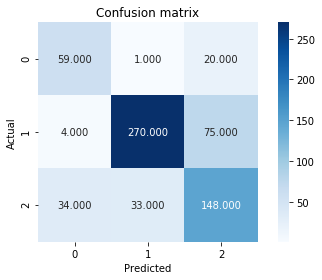

In [238]:

# Build decision tree with all parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 10  37  33]
 [ 46 190 113]
 [ 28 101  86]]
0.4440993788819876
0.5559006211180124
[0.11904762 0.57926829 0.37068966]
[0.125      0.54441261 0.4       ]
[0.12195122 0.56129985 0.38478747]


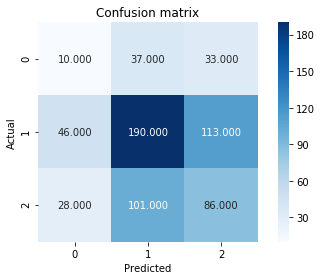

In [239]:

# Build decision tree with one parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[  9  45  26]
 [ 27 196 126]
 [ 25 108  82]]
0.44565217391304346
0.5543478260869565
[0.14754098 0.56160458 0.35042735]
[0.1125     0.56160458 0.38139535]
[0.12765957 0.56160458 0.36525612]


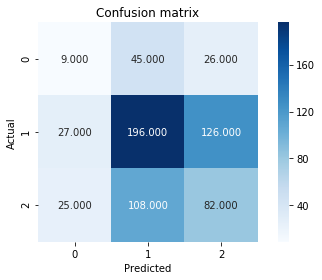

In [240]:

# Build decision tree with 2 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "Men"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "Men"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 25  19  36]
 [ 24 215 110]
 [ 32  96  87]]
0.5077639751552795
0.4922360248447205
[0.30864198 0.65151515 0.37339056]
[0.3125     0.61604585 0.40465116]
[0.31055901 0.63328424 0.38839286]


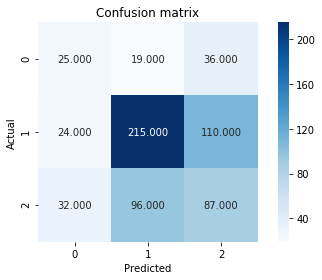

In [241]:

# Build decision tree with 2 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 29  28  23]
 [ 33 219  97]
 [ 31 102  82]]
0.5124223602484472
0.48757763975155277
[0.31182796 0.62750716 0.40594059]
[0.3625     0.62750716 0.38139535]
[0.33526012 0.62750716 0.39328537]


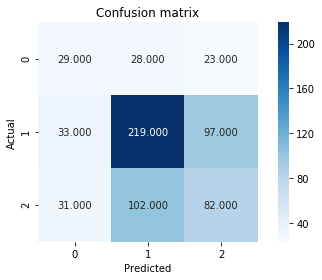

In [242]:

# Build decision tree with 3 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 36  15  29]
 [ 28 203 118]
 [ 56  65  94]]
0.5170807453416149
0.48291925465838514
[0.3        0.71731449 0.39004149]
[0.45       0.58166189 0.4372093 ]
[0.36       0.64240506 0.4122807 ]


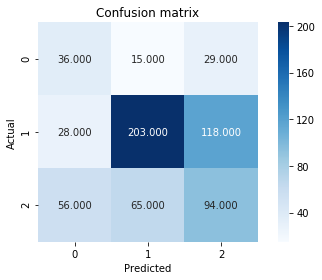

In [243]:

# Build decision tree with 4 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black","ChildPoverty"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 34   8  38]
 [ 20 218 111]
 [ 29  68 118]]
0.5745341614906833
0.42546583850931674
[0.40963855 0.7414966  0.44194757]
[0.425      0.62464183 0.54883721]
[0.41717791 0.67807154 0.48962656]


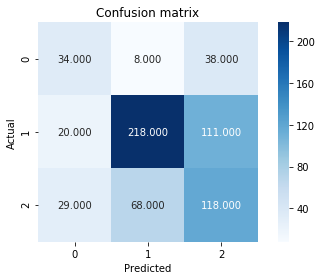

In [244]:

# Build decision tree with 5 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black","ChildPoverty", "Poverty"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 33  15  32]
 [ 23 233  93]
 [ 44  68 103]]
0.5729813664596274
0.4270186335403726
[0.33       0.73734177 0.45175439]
[0.4125     0.66762178 0.47906977]
[0.36666667 0.70075188 0.46501129]


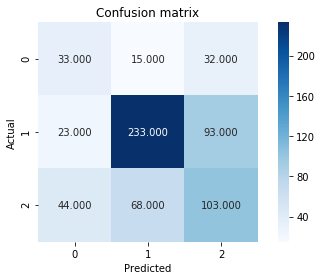

In [245]:

# Build decision tree with 6 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "IncomePerCap"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "IncomePerCap"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 33  11  36]
 [ 20 235  94]
 [ 33  74 108]]
0.5838509316770186
0.4161490683229814
[0.38372093 0.734375   0.45378151]
[0.4125     0.67335244 0.50232558]
[0.39759036 0.70254111 0.47682119]


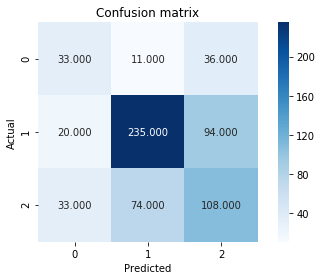

In [246]:

# Build decision tree with 6 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income"]] 
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income"]] 
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 32  10  38]
 [ 19 245  85]
 [ 34  74 107]]
0.5962732919254659
0.40372670807453415
[0.37647059 0.74468085 0.46521739]
[0.4        0.70200573 0.49767442]
[0.38787879 0.72271386 0.48089888]


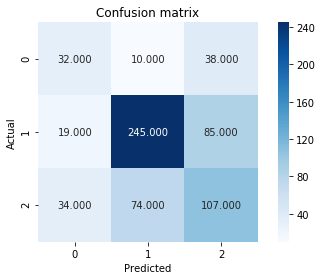

In [247]:

# Build decision tree with 7 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 58   0  22]
 [  8 251  90]
 [ 40  18 157]]
0.7236024844720497
0.27639751552795033
[0.54716981 0.9330855  0.58364312]
[0.725      0.71919771 0.73023256]
[0.62365591 0.81229773 0.64876033]


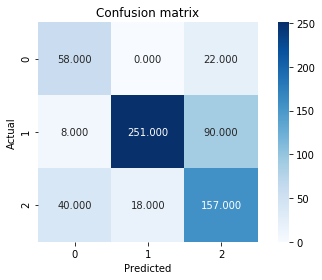

In [248]:

# Build decision tree with 8 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 61   0  19]
 [  6 260  83]
 [ 49  24 142]]
0.718944099378882
0.28105590062111796
[0.52586207 0.91549296 0.58196721]
[0.7625     0.74498567 0.66046512]
[0.62244898 0.82148499 0.61873638]


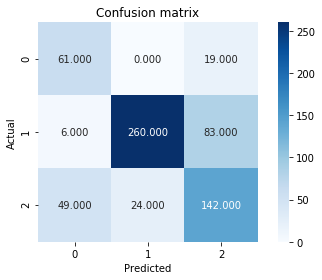

In [249]:

# Build decision tree with 9 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 16 and 44']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 16 and 44']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 61   0  19]
 [  8 254  87]
 [ 55  23 137]]
0.7018633540372671
0.2981366459627329
[0.49193548 0.91696751 0.56378601]
[0.7625    0.7277937 0.6372093]
[0.59803922 0.8115016  0.59825328]


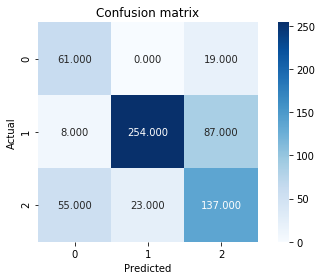

In [250]:

# Build decision tree with 9 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 45 and 74']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 45 and 74']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 58   0  22]
 [ 13 259  77]
 [ 39  26 150]]
0.7251552795031055
0.27484472049689446
[0.52727273 0.90877193 0.60240964]
[0.725      0.74212034 0.69767442]
[0.61052632 0.8170347  0.64655172]


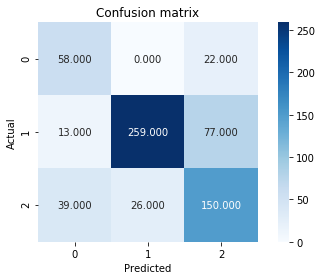

In [251]:

# Build decision tree with 9 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 67   0  13]
 [  8 263  78]
 [ 44  21 150]]
0.7453416149068323
0.25465838509316774
[0.56302521 0.92605634 0.62240664]
[0.8375     0.75358166 0.69767442]
[0.67336683 0.83096367 0.65789474]


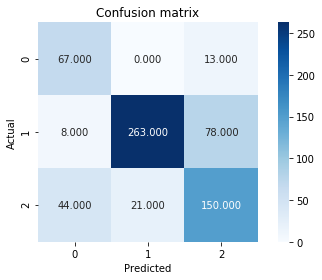

In [252]:

# Build decision tree with 9 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 64   0  16]
 [  5 265  79]
 [ 35  24 156]]
0.7531055900621118
0.24689440993788825
[0.61538462 0.91695502 0.62151394]
[0.8        0.75931232 0.7255814 ]
[0.69565217 0.830721   0.6695279 ]


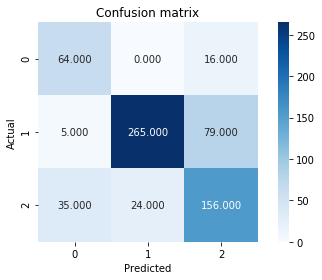

In [253]:

# Build decision tree with 10 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 63   0  17]
 [  8 270  71]
 [ 38  24 153]]
0.7546583850931677
0.24534161490683226
[0.57798165 0.91836735 0.63485477]
[0.7875     0.77363897 0.71162791]
[0.66666667 0.83981337 0.67105263]


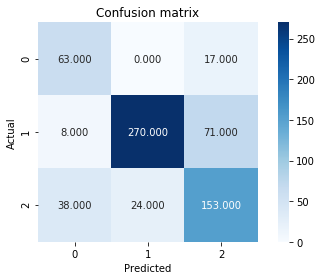

In [254]:

# Build decision tree with 11 parameters
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Asian']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Asian']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 65   0  15]
 [  5 259  85]
 [ 37  23 155]]
0.7437888198757764
0.2562111801242236
[0.60747664 0.91843972 0.60784314]
[0.8125     0.74212034 0.72093023]
[0.69518717 0.82091918 0.65957447]


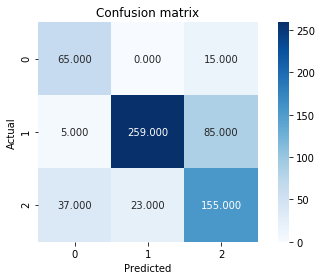

In [255]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Pacific']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Pacific']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 61   0  19]
 [  5 266  78]
 [ 36  27 152]]
0.7437888198757764
0.2562111801242236
[0.59803922 0.90784983 0.61044177]
[0.7625     0.76217765 0.70697674]
[0.67032967 0.82866044 0.65517241]


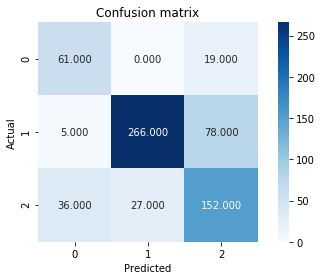

In [256]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Service']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Service']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 63   0  17]
 [  6 255  88]
 [ 51  19 145]]
0.718944099378882
0.28105590062111796
[0.525      0.93065693 0.58      ]
[0.7875     0.73065903 0.6744186 ]
[0.63       0.81861958 0.62365591]


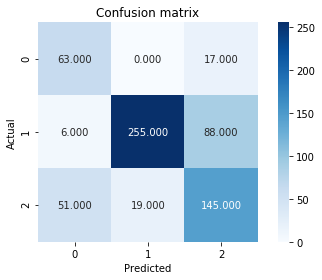

In [257]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Office']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Office']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 63   1  16]
 [  9 262  78]
 [ 39  24 152]]
0.7406832298136646
0.25931677018633537
[0.56756757 0.91289199 0.61788618]
[0.7875     0.75071633 0.70697674]
[0.65968586 0.82389937 0.65943601]


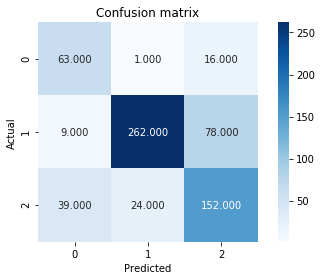

In [258]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Construction']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Construction']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 57   1  22]
 [  6 260  83]
 [ 27  30 158]]
0.7375776397515528
0.26242236024844723
[0.63333333 0.89347079 0.60076046]
[0.7125     0.74498567 0.73488372]
[0.67058824 0.8125     0.66108787]


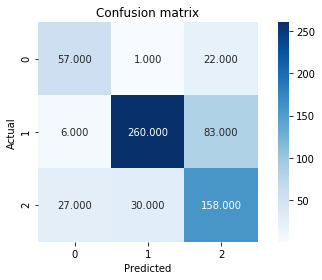

In [259]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Production']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Production']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 60   0  20]
 [  8 257  84]
 [ 39  28 148]]
0.7220496894409938
0.2779503105590062
[0.56074766 0.90175439 0.58730159]
[0.75       0.73638968 0.68837209]
[0.64171123 0.81072555 0.63383298]


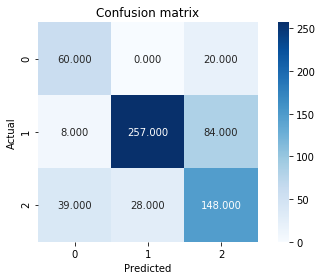

In [260]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Drive']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Drive']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 59   0  21]
 [  6 268  75]
 [ 39  28 148]]
0.7375776397515528
0.26242236024844723
[0.56730769 0.90540541 0.60655738]
[0.7375     0.76790831 0.68837209]
[0.64130435 0.83100775 0.64488017]


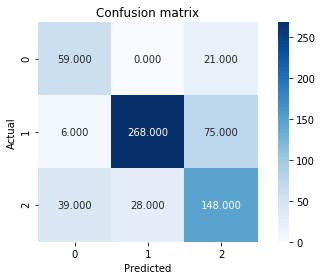

In [261]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Carpool']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', 'Carpool']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 65   0  15]
 [ 11 260  78]
 [ 41  29 145]]
0.7298136645962733
0.2701863354037267
[0.55555556 0.89965398 0.6092437 ]
[0.8125     0.74498567 0.6744186 ]
[0.65989848 0.81504702 0.6401766 ]


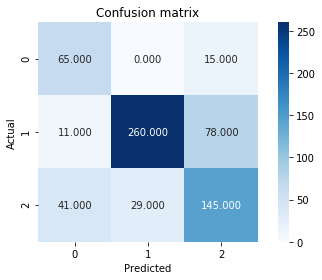

In [262]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Transit"]] 
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Transit"]] 
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 64   1  15]
 [  5 272  72]
 [ 34  24 157]]
0.765527950310559
0.23447204968944102
[0.62135922 0.91582492 0.64344262]
[0.8        0.77936963 0.73023256]
[0.69945355 0.84210526 0.68409586]


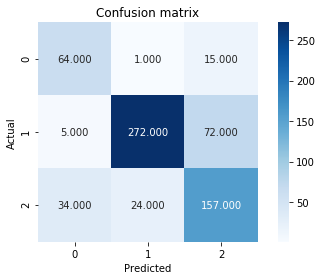

In [263]:

# Build decision tree with 11 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk"]] 
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk"]] 
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 63   2  15]
 [  7 271  71]
 [ 45  27 143]]
0.7406832298136646
0.25931677018633537
[0.54782609 0.90333333 0.62445415]
[0.7875     0.7765043  0.66511628]
[0.64615385 0.83513097 0.64414414]


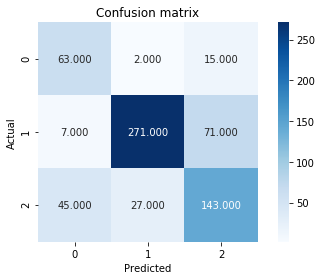

In [264]:
# Build decision tree with 12 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk", "WorkAtHome"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk", "WorkAtHome"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 67   0  13]
 [  6 257  86]
 [ 41  29 145]]
0.7282608695652174
0.2717391304347826
[0.5877193 0.8986014 0.5942623]
[0.8375     0.73638968 0.6744186 ]
[0.69072165 0.80944882 0.63180828]


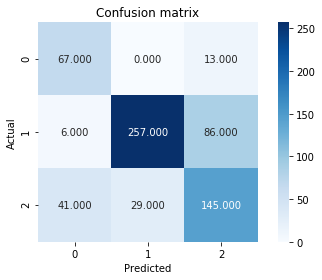

In [265]:
# Build decision tree with 12 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk", 'Mean Commute Time']]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk", 'Mean Commute Time']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 65   1  14]
 [  5 263  81]
 [ 36  22 157]]
0.7531055900621118
0.24689440993788825
[0.61320755 0.91958042 0.62301587]
[0.8125     0.75358166 0.73023256]
[0.69892473 0.82834646 0.67237687]


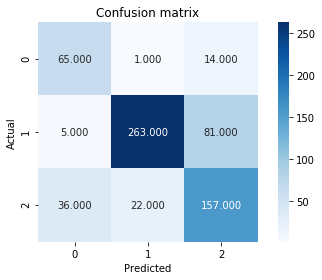

In [266]:
# Build decision tree with 12 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk", "State Unemployment rate for 2013"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["TotalPop", "White", "Black", "ChildPoverty", "Poverty", "Median Household Income", "Citizen Voting Age Pop", 
             "County Unemployment Rate for 2013", 'Hispanic', 'Native', "Walk","State Unemployment rate for 2013"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 62   2  16]
 [  0 279  70]
 [ 30  20 165]]
0.7857142857142857
0.2142857142857143
[0.67391304 0.9269103  0.65737052]
[0.775      0.79942693 0.76744186]
[0.72093023 0.85846154 0.70815451]


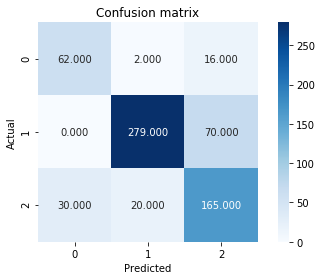

In [267]:
# Build decision tree with 12 parameter
model = tree.DecisionTreeClassifier(criterion = "entropy", random_state = 0)
x = x_train[["County Unemployment Rate for 2013"]]
y = y_train
model.fit(x,y)

# Show decision tree
#model.tree_.__getstate__()['nodes']

# Predict class labels using decision tree
x_test = x_val[["County Unemployment Rate for 2013"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()


# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [268]:
# Decision tree with 1 parameter gave the best F1 Scores
# "County Unemployment Rate for 2013", 
# [0.72093023 0.85846154 0.70815451]] is the best decision tree classifier

In [269]:
# Naive Bayes

In [270]:
# 6 parameters = .78, .49, .50
#"TotalPop","ChildPoverty", "IncomePerCap","Poverty","Median Household Income","Black"

# "County Unemployment Rate for 2013"
# 0.86728395 0.74166667 0.7625

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


[[  0  75   5]
 [  0 330  19]
 [  0 198  17]]
0.5388198757763976
0.46118012422360244
[0.         0.54726368 0.41463415]
[0.         0.94555874 0.07906977]
[0.         0.69327731 0.1328125 ]


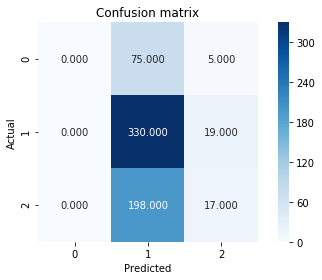

In [271]:
# Naive Bayes
model = GaussianNB()
x = x_train[["TotalPop"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 57   3  20]
 [ 18 291  40]
 [ 57  50 108]]
0.7080745341614907
0.2919254658385093
[0.43181818 0.84593023 0.64285714]
[0.7125     0.83381089 0.50232558]
[0.53773585 0.83982684 0.56396867]


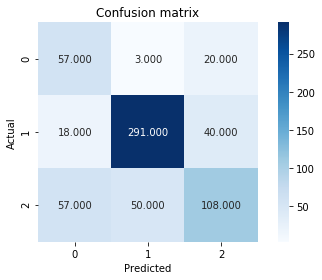

In [272]:
model = GaussianNB()
x = x_train
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


[[  0  75   5]
 [  0 329  20]
 [  0 196  19]]
0.5403726708074534
0.45962732919254656
[0.         0.54833333 0.43181818]
[0.         0.94269341 0.08837209]
[0.         0.69336143 0.14671815]


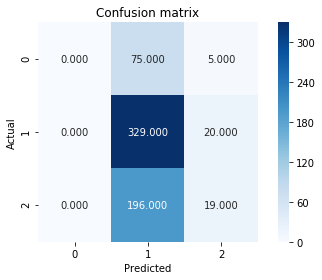

In [273]:
# Naive Bayes with 2 parameters
model = GaussianNB()
x = x_train[["TotalPop","Men"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop","Men"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 38  37   5]
 [ 14 317  18]
 [ 24 171  20]]
0.5822981366459627
0.41770186335403725
[0.5        0.60380952 0.46511628]
[0.475      0.90830946 0.09302326]
[0.48717949 0.72540046 0.15503876]


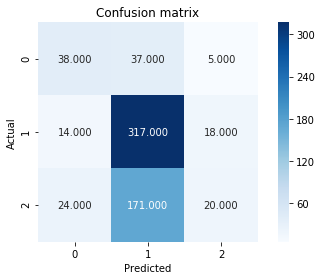

In [274]:
# Naive Bayes with 2 parameters
model = GaussianNB()
x = x_train[["TotalPop","White"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop","White"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 41  27  12]
 [ 17 305  27]
 [ 34 145  36]]
0.593167701863354
0.406832298136646
[0.44565217 0.639413   0.48      ]
[0.5125     0.8739255  0.16744186]
[0.47674419 0.73849879 0.24827586]


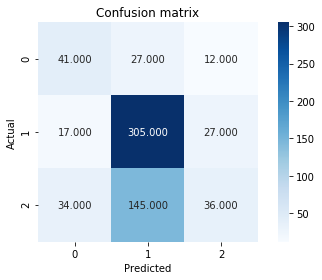

In [275]:
# Naive Bayes with 3 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop","White", "Black"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 45  27   8]
 [ 23 303  23]
 [ 43 145  27]]
0.5822981366459627
0.41770186335403725
[0.40540541 0.63789474 0.46551724]
[0.5625     0.86819484 0.1255814 ]
[0.47120419 0.73543689 0.1978022 ]


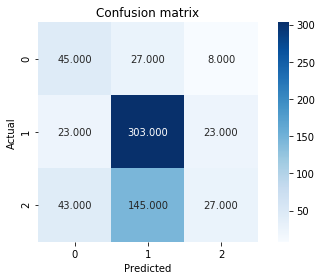

In [276]:
# Naive Bayes with 4 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Citizen Voting Age Pop"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 38  26  16]
 [  9 315  25]
 [ 21 146  48]]
0.6226708074534162
0.3773291925465838
[0.55882353 0.64681725 0.53932584]
[0.475      0.9025788  0.22325581]
[0.51351351 0.75358852 0.31578947]


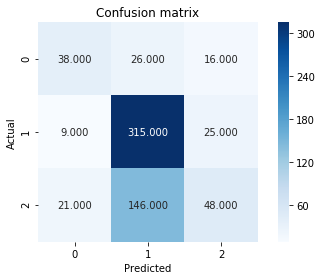

In [277]:
# Naive Bayes with 4 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 35  26  19]
 [  8 321  20]
 [ 17 145  53]]
0.6350931677018633
0.3649068322981367
[0.58333333 0.65243902 0.57608696]
[0.4375     0.91977077 0.24651163]
[0.5        0.76337693 0.34527687]


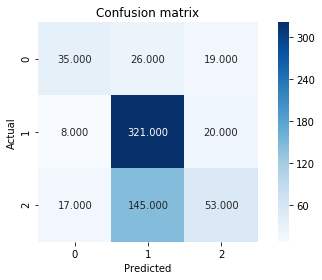

In [278]:
# Naive Bayes with 5 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 35  17  28]
 [  8 312  29]
 [ 19 114  82]]
0.6661490683229814
0.3338509316770186
[0.56451613 0.70428894 0.58992806]
[0.4375     0.89398281 0.38139535]
[0.49295775 0.78787879 0.46327684]


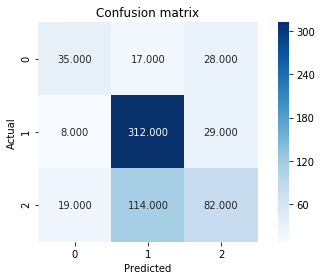

In [279]:
# Naive Bayes with 6 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 40  10  30]
 [ 10 291  48]
 [ 27  93  95]]
0.6614906832298136
0.33850931677018636
[0.51948052 0.73857868 0.54913295]
[0.5        0.83381089 0.44186047]
[0.50955414 0.7833109  0.48969072]


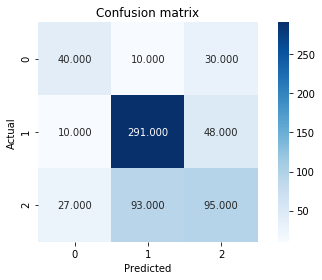

In [280]:
# Naive Bayes with 7 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 41  12  27]
 [ 12 293  44]
 [ 32 100  83]]
0.6475155279503105
0.35248447204968947
[0.48235294 0.72345679 0.53896104]
[0.5125     0.83954155 0.38604651]
[0.4969697  0.77718833 0.4498645 ]


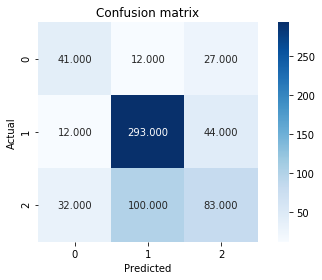

In [281]:
# Naive Bayes with 8 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", "Men"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", "Men"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 295  45]
 [ 26  38 151]]
0.7670807453416149
0.23291925465838514
[0.57831325 0.88059701 0.66814159]
[0.6        0.84527221 0.70232558]
[0.58895706 0.8625731  0.68480726]


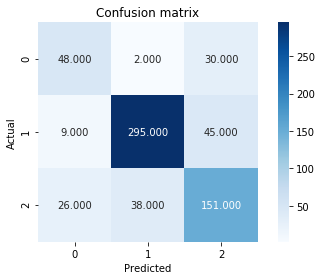

In [282]:
# Naive Bayes 2013
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013"]]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", "County Unemployment Rate for 2013"]]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 47   2  31]
 [ 10 291  48]
 [ 26  39 150]]
0.7577639751552795
0.2422360248447205
[0.56626506 0.87650602 0.65502183]
[0.5875     0.83381089 0.69767442]
[0.57668712 0.85462555 0.67567568]


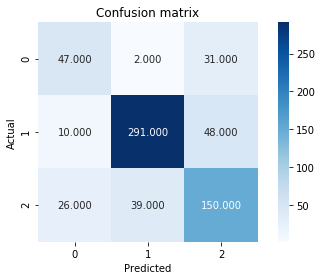

In [283]:
# Naive Bayes with 9 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 16 and 44']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 16 and 44']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 63   2  15]
 [ 15 299  35]
 [ 58  48 109]]
0.7313664596273292
0.26863354037267084
[0.46323529 0.85673352 0.68553459]
[0.7875     0.85673352 0.50697674]
[0.58333333 0.85673352 0.5828877 ]


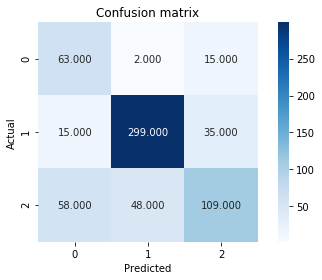

In [284]:
# Naive Bayes with 9 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 45 and 74']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 45 and 74']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 295  45]
 [ 24  36 155]]
0.7732919254658385
0.22670807453416153
[0.59259259 0.88588589 0.67391304]
[0.6        0.84527221 0.72093023]
[0.59627329 0.86510264 0.69662921]


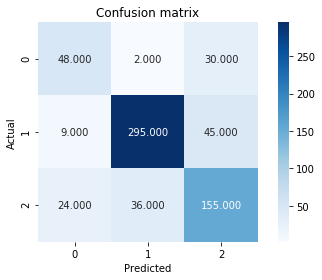

In [285]:
# Naive Bayes with 9 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 49   2  29]
 [ 11 294  44]
 [ 24  39 152]]
0.7686335403726708
0.23136645962732916
[0.58333333 0.87761194 0.67555556]
[0.6125     0.84240688 0.70697674]
[0.59756098 0.85964912 0.69090909]


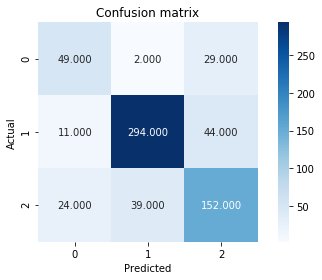

In [286]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Hispanic']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Hispanic']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 46   2  32]
 [  7 295  47]
 [ 26  41 148]]
0.7593167701863354
0.24068322981366463
[0.58227848 0.87278107 0.65198238]
[0.575      0.84527221 0.68837209]
[0.57861635 0.8588064  0.66968326]


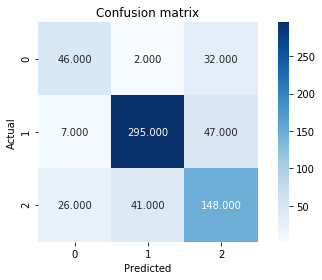

In [287]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Native']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Native']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 50   2  28]
 [  9 285  55]
 [ 28  35 152]]
0.7562111801242236
0.24378881987577639
[0.57471264 0.88509317 0.64680851]
[0.625      0.81661891 0.70697674]
[0.5988024  0.84947839 0.67555556]


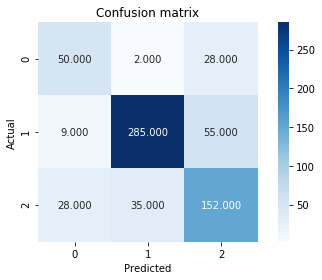

In [288]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Asian']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Asian']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 47   4  29]
 [  9 268  72]
 [ 26  41 148]]
0.718944099378882
0.28105590062111796
[0.57317073 0.85623003 0.59437751]
[0.5875     0.76790831 0.68837209]
[0.58024691 0.80966767 0.63793103]


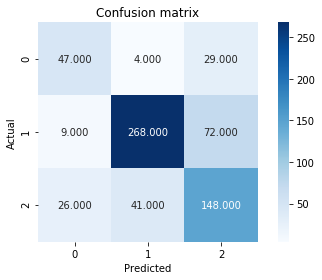

In [289]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Pacific']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Pacific']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 299  41]
 [ 22  46 147]]
0.7670807453416149
0.23291925465838514
[0.60759494 0.86167147 0.67431193]
[0.6        0.85673352 0.68372093]
[0.60377358 0.8591954  0.67898383]


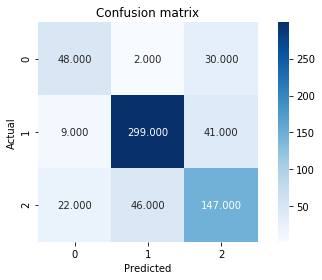

In [290]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Professional']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Professional']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [ 10 285  54]
 [ 25  39 151]]
0.7515527950310559
0.24844720496894412
[0.57831325 0.87423313 0.64255319]
[0.6        0.81661891 0.70232558]
[0.58895706 0.84444444 0.67111111]


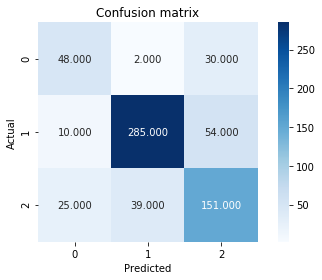

In [291]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Service']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Service']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [ 10 293  46]
 [ 25  35 155]]
0.7701863354037267
0.22981366459627328
[0.57831325 0.88787879 0.67099567]
[0.6        0.83954155 0.72093023]
[0.58895706 0.86303387 0.69506726]


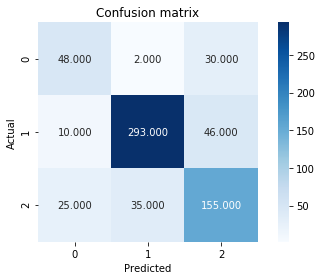

In [292]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Office']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Office']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

[[ 48   2  30]
 [  9 294  46]
 [ 25  38 152]]
0.7670807453416149
0.23291925465838514
[0.58536585 0.88023952 0.66666667]
[0.6        0.84240688 0.70697674]
[0.59259259 0.86090776 0.68623025]


C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


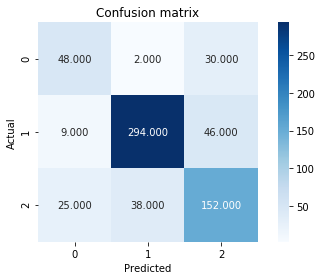

In [293]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Construction']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Construction']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 294  46]
 [ 23  37 155]]
0.7717391304347826
0.2282608695652174
[0.6        0.88288288 0.67099567]
[0.6        0.84240688 0.72093023]
[0.6        0.86217009 0.69506726]


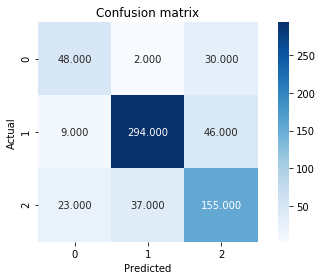

In [294]:
# Naive Bayes with 10 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 47   2  31]
 [  8 287  54]
 [ 21  37 157]]
0.7624223602484472
0.23757763975155277
[0.61842105 0.8803681  0.64876033]
[0.5875     0.82234957 0.73023256]
[0.6025641  0.85037037 0.68708972]


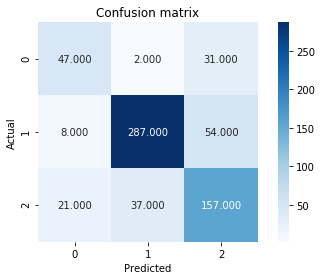

In [295]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Drive']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Drive']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 51   2  27]
 [  9 292  48]
 [ 29  37 149]]
0.7639751552795031
0.2360248447204969
[0.57303371 0.88217523 0.66517857]
[0.6375     0.83667622 0.69302326]
[0.6035503  0.85882353 0.67881549]


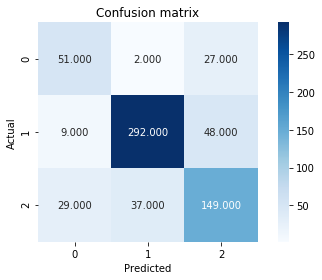

In [296]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Carpool']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Carpool']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 294  46]
 [ 23  41 151]]
0.765527950310559
0.23447204968944102
[0.6        0.87240356 0.66519824]
[0.6        0.84240688 0.70232558]
[0.6        0.85714286 0.68325792]


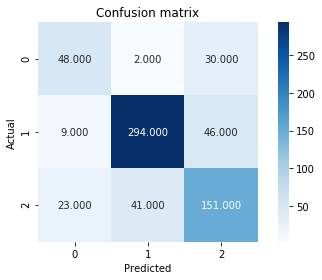

In [297]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Transit']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Transit']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [ 10 292  47]
 [ 21  40 154]]
0.7670807453416149
0.23291925465838514
[0.60759494 0.8742515  0.66666667]
[0.6        0.83667622 0.71627907]
[0.60377358 0.85505124 0.69058296]


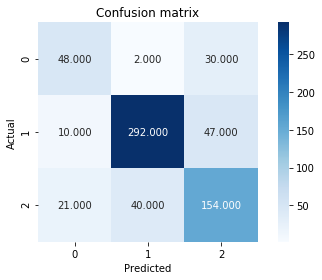

In [298]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Walk']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Walk']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 288  52]
 [ 26  44 145]]
0.7468944099378882
0.25310559006211175
[0.57831325 0.86227545 0.63876652]
[0.6       0.8252149 0.6744186]
[0.58895706 0.84333821 0.6561086 ]


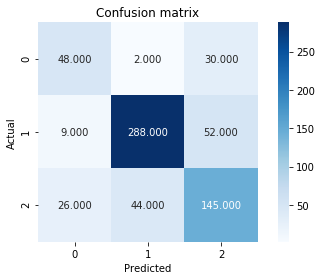

In [299]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','WorkAtHome']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','WorkAtHome']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 48   2  30]
 [  9 292  48]
 [ 23  41 151]]
0.7624223602484472
0.23757763975155277
[0.6        0.87164179 0.65938865]
[0.6        0.83667622 0.70232558]
[0.6        0.85380117 0.68018018]


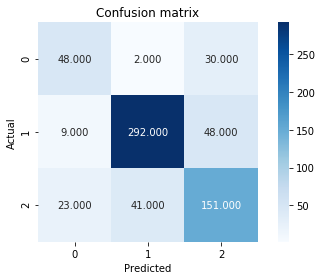

In [300]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Mean Commute Time']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production','Mean Commute Time']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 47   2  31]
 [  9 288  52]
 [ 19  34 162]]
0.7717391304347826
0.2282608695652174
[0.62666667 0.88888889 0.66122449]
[0.5875     0.8252149  0.75348837]
[0.60645161 0.85586924 0.70434783]


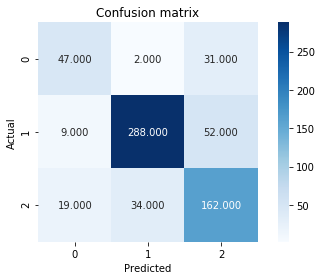

In [301]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
             "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production',
             'State Unemployment rate for 2013']]
y = y_train
model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["TotalPop", "White", "Black","Median Household Income","IncomePerCap","Poverty","ChildPoverty", 
                "County Unemployment Rate for 2013", 'Percent Population with age between 75 and over', 'Production',
                'State Unemployment rate for 2013']]
y_pred = model.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[[ 61   0  19]
 [  0 281  68]
 [ 19  18 178]]
0.8074534161490683
0.1925465838509317
[0.7625     0.93979933 0.67169811]
[0.7625     0.80515759 0.82790698]
[0.7625     0.86728395 0.74166667]


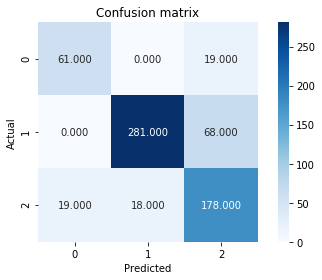

In [302]:
# Naive Bayes with 11 parameters
model = GaussianNB()
x = x_train[["County Unemployment Rate for 2013"]]
y = y_train
Classifier = model.fit(x,y)

# Predict class labels using Naive Bayes classifier
x_test = x_val[["County Unemployment Rate for 2013"]]
y_pred = Classifier.predict(x_test)

# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# TASK 4
# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [303]:
#In case of Naive Bayes, the classifier with parameter:
# "County Unemployment Rate for 2013"
# is the best one with F1 Scores:
# [0.7625     0.86728395 0.74166667]

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 12  45  23]
 [ 54 191 104]
 [ 37 115  63]]
0.41304347826086957
0.5869565217391304
[0.11650485 0.54415954 0.33157895]
[0.15       0.54727794 0.29302326]
[0.13114754 0.54571429 0.31111111]


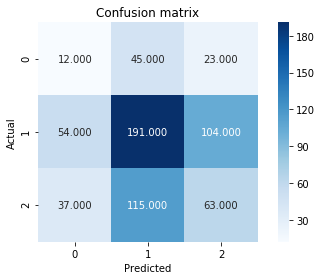

In [304]:
# K nearest neighbour with k = 3 and 1 parameter
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 11  45  24]
 [ 42 226  81]
 [ 27 124  64]]
0.4673913043478261
0.5326086956521738
[0.1375     0.5721519  0.37869822]
[0.1375     0.64756447 0.29767442]
F1 Score is: 
[0.1375     0.60752688 0.33333333]


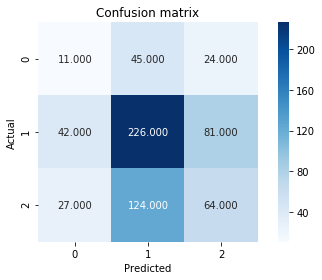

In [305]:
# K nearest neighbour with k = 3 and 2 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 37  21  22]
 [ 33 225  91]
 [ 32 108  75]]
0.5232919254658385
0.47670807453416153
[0.3627451  0.63559322 0.39893617]
[0.4625     0.64469914 0.34883721]
F1 Score is: 
[0.40659341 0.6401138  0.37220844]


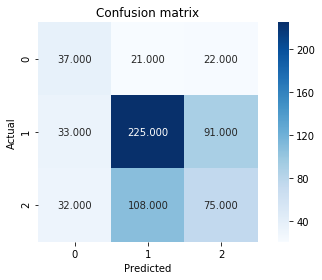

In [306]:
# K nearest neighbour with k = 3 and 3 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 37  22  21]
 [ 43 221  85]
 [ 41  99  75]]
0.5170807453416149
0.48291925465838514
[0.30578512 0.64619883 0.41436464]
[0.4625     0.63323782 0.34883721]
F1 Score is: 
[0.3681592  0.63965268 0.37878788]


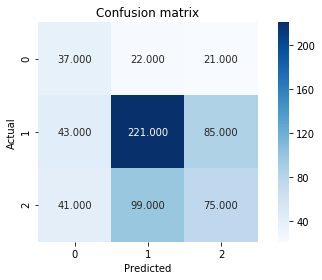

In [307]:
# K nearest neighbour with k = 3 and 4 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Black"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Black"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 38  22  20]
 [ 36 226  87]
 [ 33 104  78]]
0.531055900621118
0.46894409937888204
[0.35514019 0.64204545 0.42162162]
[0.475      0.64756447 0.3627907 ]
F1 Score is: 
[0.40641711 0.64479315 0.39      ]


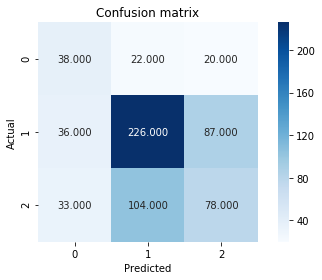

In [308]:
# K nearest neighbour with k = 3 and 4 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Citizen Voting Age Pop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", 'Citizen Voting Age Pop']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 41  18  21]
 [ 14 287  48]
 [ 30 104  81]]
0.6350931677018633
0.3649068322981367
[0.48235294 0.70171149 0.54      ]
[0.5125     0.82234957 0.37674419]
F1 Score is: 
[0.4969697  0.75725594 0.44383562]


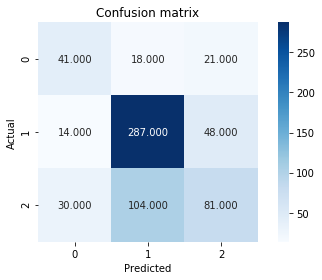

In [309]:
# K nearest neighbour with k = 3 and 5 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", 'Median Household Income', 'Citizen Voting Age Pop']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 33  23  24]
 [ 15 287  47]
 [ 32 122  61]]
0.5916149068322981
0.4083850931677019
[0.4125     0.66435185 0.46212121]
[0.4125     0.82234957 0.28372093]
F1 Score is: 
[0.4125     0.73495519 0.35158501]


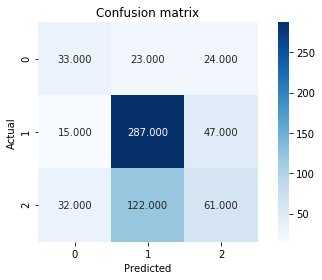

In [310]:
# K nearest neighbour with k = 3 and 6 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 37  11  32]
 [ 30 256  63]
 [ 39  81  95]]
0.6024844720496895
0.39751552795031053
[0.3490566  0.73563218 0.5       ]
[0.4625     0.73352436 0.44186047]
F1 Score is: 
[0.39784946 0.73457676 0.4691358 ]


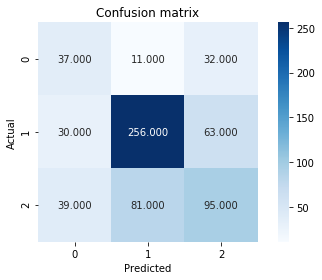

In [311]:
# K nearest neighbour with k = 3 and 6 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "Poverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "Poverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  16  20]
 [ 21 253  75]
 [ 51  82  82]]
0.5885093167701864
0.41149068322981364
[0.37931034 0.72079772 0.46327684]
[0.55       0.72492837 0.38139535]
F1 Score is: 
[0.44897959 0.72285714 0.41836735]


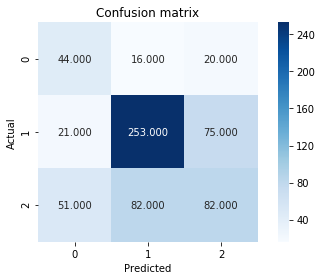

In [312]:
# K nearest neighbour with k = 3 and 6 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "ChildPoverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', "ChildPoverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 64   2  14]
 [  1 288  60]
 [ 25  33 157]]
0.7903726708074534
0.20962732919254656
[0.71111111 0.89164087 0.67965368]
[0.8        0.8252149  0.73023256]
F1 Score is: 
[0.75294118 0.85714286 0.70403587]


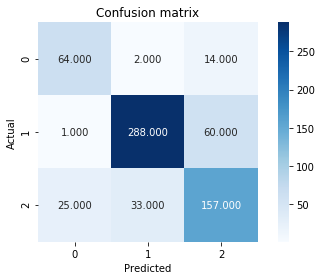

In [313]:
# K nearest neighbour with k = 3 and 6 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 'County Unemployment Rate for 2013']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 'County Unemployment Rate for 2013']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 68   2  10]
 [  3 282  64]
 [ 36  36 143]]
0.765527950310559
0.23447204968944102
[0.63551402 0.88125    0.65898618]
[0.85       0.80802292 0.66511628]
F1 Score is: 
[0.72727273 0.84304933 0.66203704]


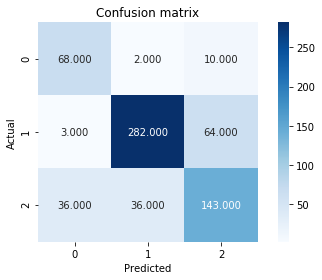

In [314]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Percent Population with age between 16 and 44']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
                'County Unemployment Rate for 2013', 'Percent Population with age between 16 and 44']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 65   3  12]
 [  5 282  62]
 [ 54  42 119]]
0.7236024844720497
0.27639751552795033
[0.52419355 0.86238532 0.61658031]
[0.8125     0.80802292 0.55348837]
F1 Score is: 
[0.6372549  0.83431953 0.58333333]


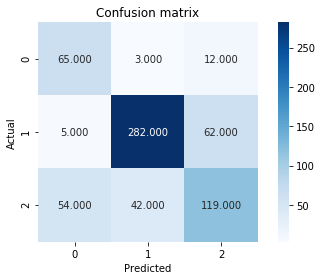

In [315]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013','Percent Population with age between 45 and 74']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Percent Population with age between 45 and 74']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 63   2  15]
 [  3 285  61]
 [ 33  34 148]]
0.7701863354037267
0.22981366459627328
[0.63636364 0.88785047 0.66071429]
[0.7875     0.81661891 0.68837209]
F1 Score is: 
[0.70391061 0.85074627 0.67425968]


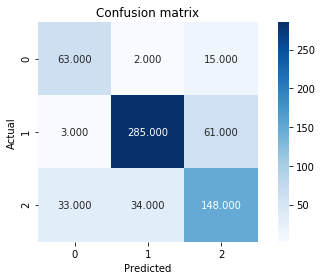

In [316]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013','Percent Population with age between 75 and over']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Percent Population with age between 75 and over']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 59   2  19]
 [  1 287  61]
 [ 26  28 161]]
0.7872670807453416
0.21273291925465843
[0.68604651 0.90536278 0.66804979]
[0.7375     0.82234957 0.74883721]
F1 Score is: 
[0.71084337 0.86186186 0.70614035]


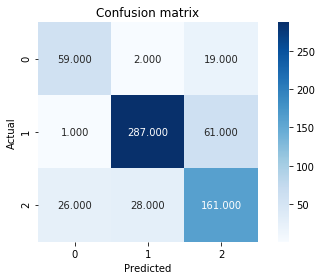

In [317]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Hispanic']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Hispanic']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 64   2  14]
 [  6 287  56]
 [ 28  33 154]]
0.7841614906832298
0.21583850931677018
[0.65306122 0.89130435 0.6875    ]
[0.8        0.82234957 0.71627907]
F1 Score is: 
[0.71910112 0.85543964 0.70159453]


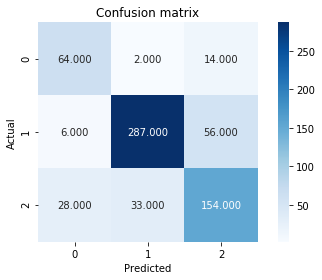

In [318]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Native']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Native']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 60   1  19]
 [  1 278  70]
 [ 24  31 160]]
0.7732919254658385
0.22670807453416153
[0.70588235 0.89677419 0.64257028]
[0.75       0.7965616  0.74418605]
F1 Score is: 
[0.72727273 0.84370258 0.68965517]


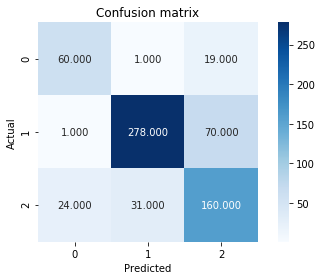

In [319]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Asian']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Asian']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 64   2  14]
 [  1 286  62]
 [ 26  34 155]]
0.7841614906832298
0.21583850931677018
[0.7032967  0.88819876 0.67099567]
[0.8        0.81948424 0.72093023]
F1 Score is: 
[0.74853801 0.85245902 0.69506726]


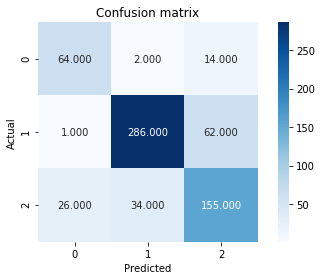

In [320]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Pacific']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Pacific']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 61   2  17]
 [  3 285  61]
 [ 34  34 147]]
0.765527950310559
0.23447204968944102
[0.62244898 0.88785047 0.65333333]
[0.7625     0.81661891 0.68372093]
F1 Score is: 
[0.68539326 0.85074627 0.66818182]


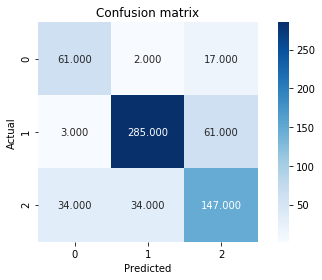

In [321]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Professional']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Professional']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 58   1  21]
 [  3 282  64]
 [ 29  29 157]]
0.7717391304347826
0.2282608695652174
[0.64444444 0.90384615 0.64876033]
[0.725      0.80802292 0.73023256]
F1 Score is: 
[0.68235294 0.85325265 0.68708972]


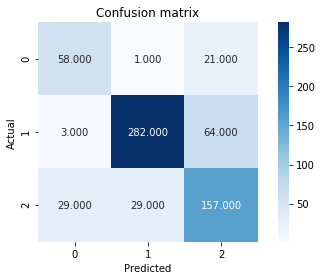

In [322]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Service']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Service']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 65   3  12]
 [  4 277  68]
 [ 34  30 151]]
0.765527950310559
0.23447204968944102
[0.63106796 0.89354839 0.65367965]
[0.8125     0.79369628 0.70232558]
F1 Score is: 
[0.71038251 0.84066768 0.67713004]


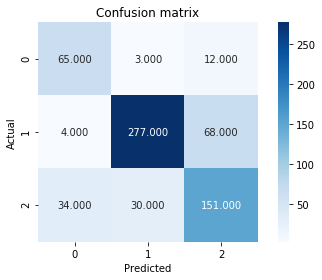

In [323]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Office']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Office']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 63   1  16]
 [  5 271  73]
 [ 34  31 150]]
0.7515527950310559
0.24844720496894412
[0.61764706 0.89438944 0.62761506]
[0.7875     0.7765043  0.69767442]
F1 Score is: 
[0.69230769 0.83128834 0.66079295]


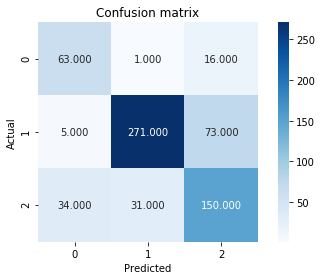

In [324]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Construction']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Construction']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 54   2  24]
 [  5 293  51]
 [ 31  35 149]]
0.7701863354037267
0.22981366459627328
[0.6        0.88787879 0.66517857]
[0.675      0.83954155 0.69302326]
F1 Score is: 
[0.63529412 0.86303387 0.67881549]


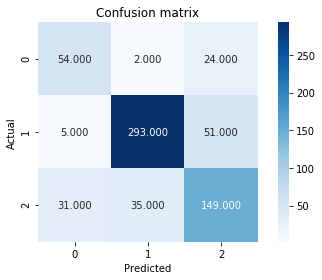

In [325]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Production']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Production']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 61   2  17]
 [  3 287  59]
 [ 28  26 161]]
0.7903726708074534
0.20962732919254656
[0.66304348 0.91111111 0.67932489]
[0.7625     0.82234957 0.74883721]
F1 Score is: 
[0.70930233 0.86445783 0.71238938]


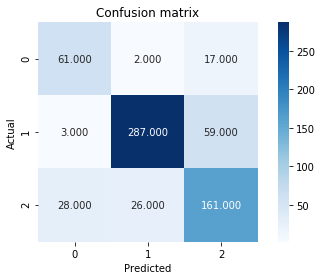

In [326]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Drive']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Drive']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 58   3  19]
 [  2 289  58]
 [ 31  35 149]]
0.7701863354037267
0.22981366459627328
[0.63736264 0.88379205 0.65929204]
[0.725      0.82808023 0.69302326]
F1 Score is: 
[0.67836257 0.85502959 0.67573696]


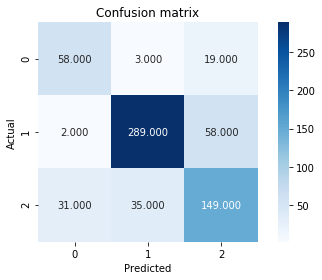

In [327]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Carpool']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Carpool']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 63   1  16]
 [  1 287  61]
 [ 28  33 154]]
0.782608695652174
0.21739130434782605
[0.68478261 0.894081   0.66666667]
[0.7875     0.82234957 0.71627907]
F1 Score is: 
[0.73255814 0.85671642 0.69058296]


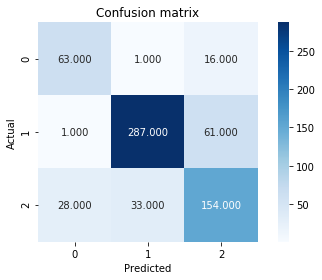

In [328]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Transit']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Transit']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 65   3  12]
 [  5 276  68]
 [ 24  26 165]]
0.7857142857142857
0.2142857142857143
[0.69148936 0.90491803 0.67346939]
[0.8125     0.79083095 0.76744186]
F1 Score is: 
[0.74712644 0.8440367  0.7173913 ]


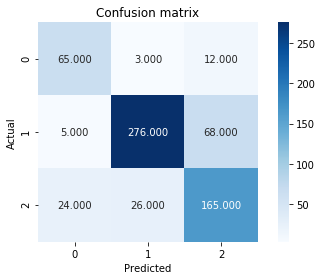

In [329]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Walk']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Walk']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 61   1  18]
 [  5 290  54]
 [ 29  37 149]]
0.7763975155279503
0.22360248447204967
[0.64210526 0.88414634 0.67420814]
[0.7625     0.83094556 0.69302326]
F1 Score is: 
[0.69714286 0.85672083 0.68348624]


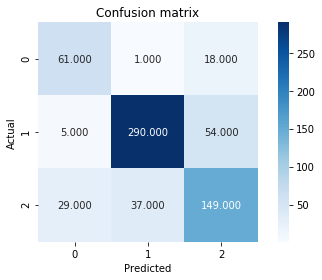

In [330]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'WorkAtHome']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'WorkAtHome']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 58   1  21]
 [  4 288  57]
 [ 37  26 152]]
0.7732919254658385
0.22670807453416153
[0.58585859 0.91428571 0.66086957]
[0.725      0.8252149  0.70697674]
F1 Score is: 
[0.64804469 0.86746988 0.68314607]


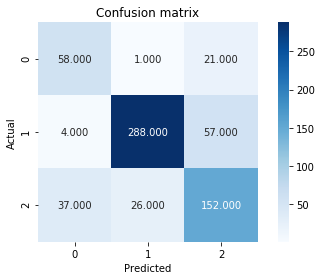

In [331]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Mean Commute Time']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'Mean Commute Time']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 62   2  16]
 [  3 294  52]
 [ 31  30 154]]
0.7919254658385093
0.2080745341614907
[0.64583333 0.90184049 0.69369369]
[0.775      0.84240688 0.71627907]
F1 Score is: 
[0.70454545 0.87111111 0.70480549]


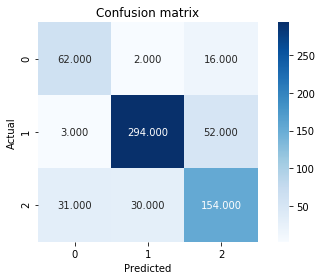

In [332]:
# K nearest neighbour with k = 3 and 7 parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'State Unemployment rate for 2013']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
             'County Unemployment Rate for 2013', 'State Unemployment rate for 2013']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 66   1  13]
 [  7 258  84]
 [ 56  17 142]]
0.7236024844720497
0.27639751552795033
[0.51162791 0.93478261 0.59414226]
[0.825      0.73925501 0.66046512]
F1 Score is: 
[0.63157895 0.8256     0.62555066]


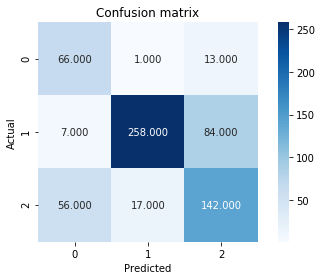

In [333]:
# K nearest neighbour with k = 3 and 'County Unemployment Rate for 2013'
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[['County Unemployment Rate for 2013']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[['County Unemployment Rate for 2013']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 54   3  23]
 [ 11 277  61]
 [ 43  44 128]]
0.7127329192546584
0.2872670807453416
[0.5        0.85493827 0.60377358]
[0.675      0.79369628 0.59534884]
F1 Score is: 
[0.57446809 0.82317979 0.59953162]


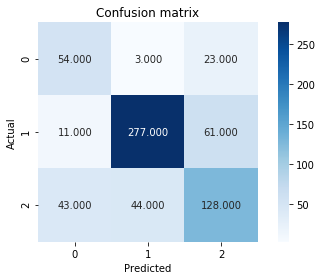

In [334]:
# K nearest neighbour with k = 3 and all parameters
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 66   1  13]
 [  7 258  84]
 [ 56  17 142]]
0.7236024844720497
0.27639751552795033
[0.51162791 0.93478261 0.59414226]
[0.825      0.73925501 0.66046512]
F1 Score is: 
[0.63157895 0.8256     0.62555066]


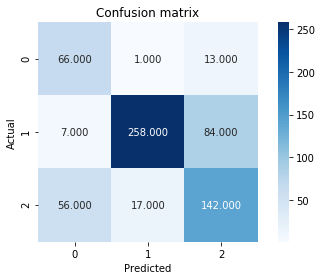

In [335]:
# K nearest neighbour with k = 3 and 'County Unemployment Rate for 2013'
model = KNeighborsClassifier(n_neighbors = 3)
x = x_train[['County Unemployment Rate for 2013']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[['County Unemployment Rate for 2013']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print("F1 Score is: ")
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [336]:
# In case of K_Nearest Neighbour with k=3, the classifier with 
# "TotalPop", "Men", "White", "Median Household Income",'Citizen Voting Age Pop', 
#  'County Unemployment Rate for 2013' is the best one with F1 Scores
# [0.75294118 0.85714286 0.70403587]

In [337]:
# K nearest neighbour K = 4

In [338]:
# K = 5 
#"TotalPop","Poverty", "Men", 'Black', 'Citizen Voting Age Pop'
# 0.73170732 0.51141553 0.50980392

#"County Unemployment Rate for 2013"
#0.83563748 0.65502183 0.69273743

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[  4  56  20]
 [ 16 255  78]
 [ 21 147  47]]
0.4751552795031056
0.5248447204968945
[0.09756098 0.55676856 0.32413793]
[0.05       0.73065903 0.21860465]
[0.0661157  0.63197026 0.26111111]


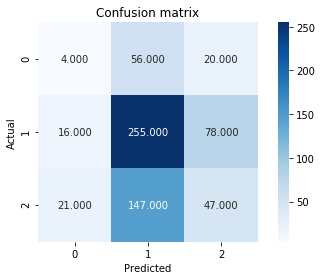

In [339]:
# K nearest neighbour with k = 4 and 1 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [340]:
# 0.63196126 0.26775956 0.0625    TotalPop


C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[  6  55  19]
 [ 16 274  59]
 [ 14 159  42]]
0.5
0.5
[0.16666667 0.56147541 0.35      ]
[0.075      0.78510029 0.19534884]
[0.10344828 0.65471924 0.25074627]


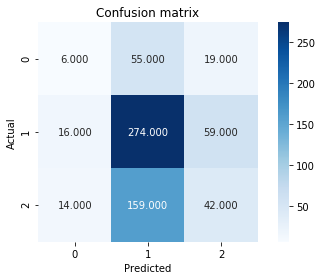

In [341]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Men"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Men"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 34  25  21]
 [ 15 271  63]
 [ 16 138  61]]
0.5683229813664596
0.43167701863354035
[0.52307692 0.62442396 0.42068966]
[0.425      0.7765043  0.28372093]
[0.46896552 0.69220945 0.33888889]


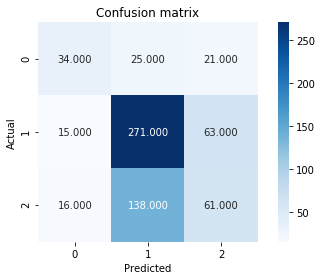

In [342]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 36  31  13]
 [ 25 273  51]
 [ 36 133  46]]
0.5512422360248447
0.4487577639751553
[0.37113402 0.62471396 0.41818182]
[0.45       0.78223496 0.21395349]
[0.40677966 0.69465649 0.28307692]


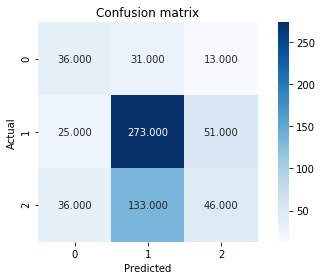

In [343]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Black"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Black"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[  6  63  11]
 [ 22 275  52]
 [ 22 163  30]]
0.4829192546583851
0.5170807453416149
[0.12       0.5489022  0.32258065]
[0.075      0.78796562 0.13953488]
[0.09230769 0.64705882 0.19480519]


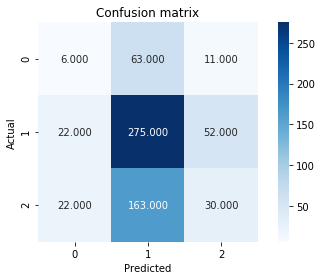

In [344]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Citizen Voting Age Pop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 18  30  32]
 [  8 310  31]
 [  8 140  67]]
0.6133540372670807
0.3866459627329193
[0.52941176 0.64583333 0.51538462]
[0.225      0.88825215 0.31162791]
[0.31578947 0.74788902 0.3884058 ]


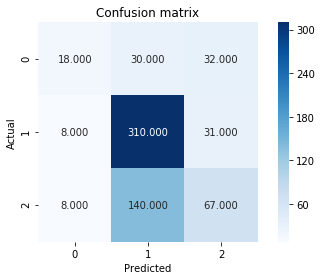

In [345]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Median Household Income"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Median Household Income"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 26  34  20]
 [  6 321  22]
 [  9 169  37]]
0.5962732919254659
0.40372670807453415
[0.63414634 0.61259542 0.46835443]
[0.325      0.91977077 0.17209302]
[0.42975207 0.73539519 0.25170068]


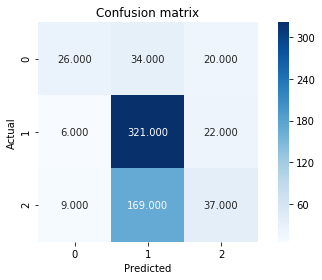

In [346]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  12  24]
 [ 21 262  66]
 [ 28 101  86]]
0.6086956521739131
0.3913043478260869
[0.47311828 0.69866667 0.48863636]
[0.55       0.75071633 0.4       ]
[0.50867052 0.72375691 0.4398977 ]


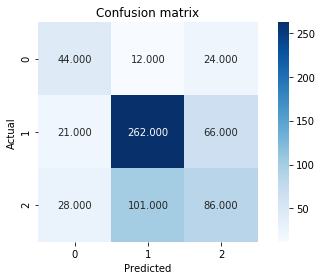

In [347]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  13  23]
 [ 27 239  83]
 [ 53  76  86]]
0.5729813664596274
0.4270186335403726
[0.35483871 0.72865854 0.44791667]
[0.55       0.68481375 0.4       ]
[0.43137255 0.70605613 0.42260442]


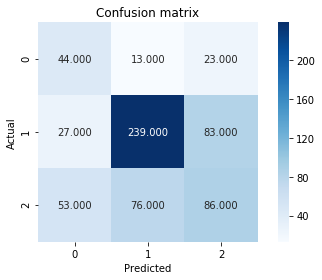

In [348]:
# K nearest neighbour with k = 4 and 2 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","ChildPoverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","ChildPoverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [349]:
# k = 4, 2 parameter
# 0.65566038 0.2716763  0.04255319
# 0.69356873 0.35040431 0.38709677
# 0.69849246 0.32844575 0.35761589
# 0.65051903 0.21587302 0.01886792
# 0.74669868 0.39655172 0.31775701
# 0.7357631  0.26666667 0.4
# 0.72275862 0.4725537  0.48611111	"TotalPop","Poverty"
# 0.7057101  0.45475638 0.42528736

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  12  24]
 [ 22 261  66]
 [ 28  99  88]]
0.610248447204969
0.38975155279503104
[0.46808511 0.7016129  0.49438202]
[0.55       0.747851   0.40930233]
[0.50574713 0.72399445 0.44783715]


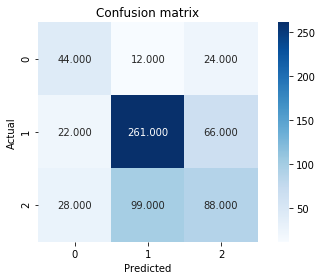

In [350]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 47  13  20]
 [ 20 260  69]
 [ 32 100  83]]
0.6055900621118012
0.3944099378881988
[0.47474747 0.69705094 0.48255814]
[0.5875     0.74498567 0.38604651]
[0.52513966 0.72022161 0.42894057]


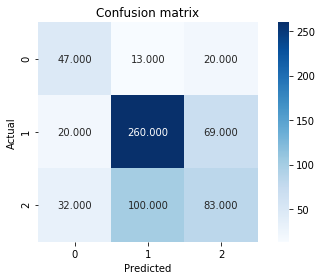

In [351]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 46  14  20]
 [ 19 260  70]
 [ 34  87  94]]
0.6211180124223602
0.3788819875776398
[0.46464646 0.72022161 0.51086957]
[0.575      0.74498567 0.4372093 ]
[0.51396648 0.73239437 0.47117794]


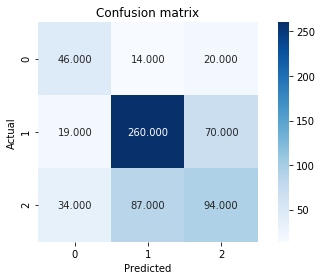

In [352]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Black"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Black"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  12  24]
 [ 23 259  67]
 [ 30  92  93]]
0.6149068322981367
0.3850931677018633
[0.45360825 0.71349862 0.50543478]
[0.55       0.74212034 0.43255814]
[0.49717514 0.72752809 0.46616541]


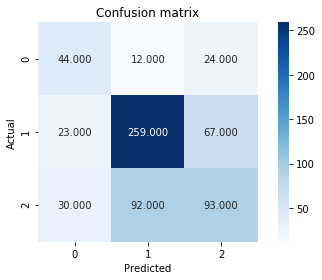

In [353]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Citizen Voting Age Pop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 34  25  21]
 [ 20 280  49]
 [ 22 127  66]]
0.5900621118012422
0.40993788819875776
[0.44736842 0.64814815 0.48529412]
[0.425      0.80229226 0.30697674]
[0.43589744 0.71702945 0.37606838]


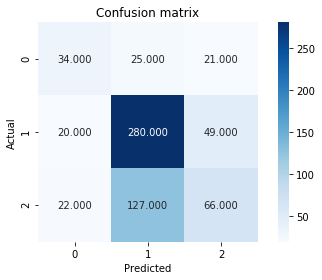

In [354]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Median Household Income"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Median Household Income"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 34  25  21]
 [  8 295  46]
 [ 22 148  45]]
0.5807453416149069
0.4192546583850931
[0.53125    0.63034188 0.40178571]
[0.425      0.84527221 0.20930233]
[0.47222222 0.72215422 0.27522936]


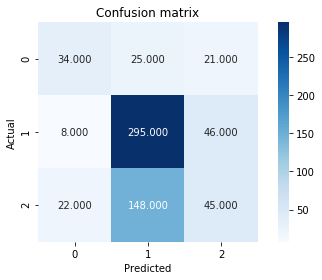

In [355]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 41  12  27]
 [ 18 264  67]
 [ 35  90  90]]
0.6133540372670807
0.3866459627329193
[0.43617021 0.72131148 0.48913043]
[0.5125     0.75644699 0.41860465]
[0.47126437 0.73846154 0.45112782]


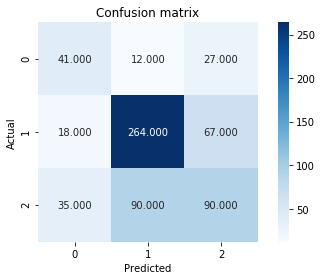

In [356]:
# K nearest neighbour with k = 4 and 3 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","ChildPoverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","ChildPoverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [357]:
# k = 4, 3 parameter
# 0.72099448 0.47281324 0.4822695		"TotalPop","Poverty","Men"
# 0.71900826 0.47596154 0.50684932
# 0.72931276 0.47867299 0.44444444
# 0.72650771 0.48598131 0.46258503
# 0.72405063 0.39130435 0.35384615
# 0.71931956 0.30177515 0.44094488
# 0.73713491 0.46808511 0.39726027



C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 46  13  21]
 [ 19 263  67]
 [ 29 102  84]]
0.610248447204969
0.38975155279503104
[0.4893617  0.6957672  0.48837209]
[0.575      0.75358166 0.39069767]
[0.52873563 0.72352132 0.43410853]


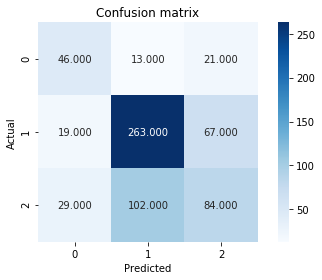

In [358]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  12  24]
 [ 19 257  73]
 [ 36  85  94]]
0.6133540372670807
0.3866459627329193
[0.44444444 0.7259887  0.4921466 ]
[0.55       0.73638968 0.4372093 ]
[0.49162011 0.7311522  0.46305419]


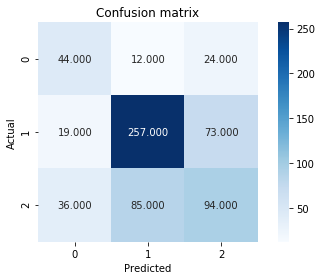

In [359]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "Black"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","Black"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 43  11  26]
 [ 23 258  68]
 [ 30  93  92]]
0.610248447204969
0.38975155279503104
[0.44791667 0.71270718 0.49462366]
[0.5375     0.73925501 0.42790698]
[0.48863636 0.7257384  0.45885287]


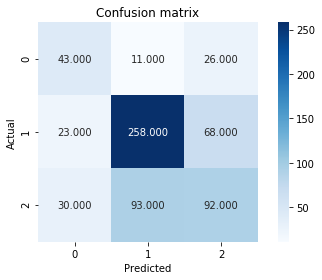

In [360]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "Citizen Voting Age Pop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 33  24  23]
 [ 18 278  53]
 [ 20 123  72]]
0.59472049689441
0.40527950310559
[0.46478873 0.65411765 0.48648649]
[0.4125     0.7965616  0.33488372]
[0.43708609 0.71834625 0.39669421]


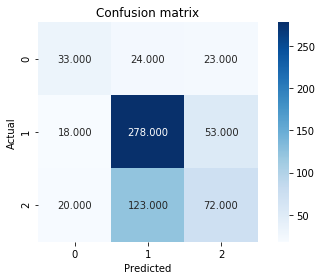

In [361]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "Median Household Income"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","Median Household Income"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 33  24  23]
 [  8 297  44]
 [ 19 145  51]]
0.5916149068322981
0.4083850931677019
[0.55       0.63733906 0.43220339]
[0.4125     0.85100287 0.2372093 ]
[0.47142857 0.72883436 0.30630631]


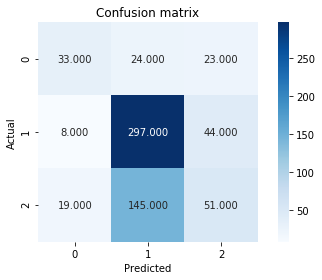

In [362]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 40  13  27]
 [ 21 265  63]
 [ 36  87  92]]
0.6164596273291926
0.38354037267080743
[0.41237113 0.7260274  0.50549451]
[0.5        0.75931232 0.42790698]
[0.4519774  0.74229692 0.46347607]


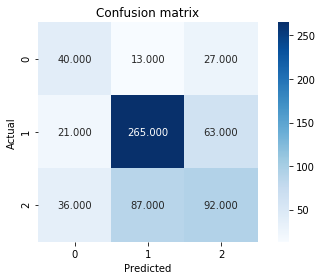

In [363]:
# K nearest neighbour with k = 4 and 4 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty","Men", "ChildPoverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty","Men","ChildPoverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 44  22  14]
 [ 16 270  63]
 [ 33  93  89]]
0.6257763975155279
0.37422360248447206
[0.47311828 0.7012987  0.53614458]
[0.55       0.77363897 0.41395349]
[0.50867052 0.73569482 0.4671916 ]


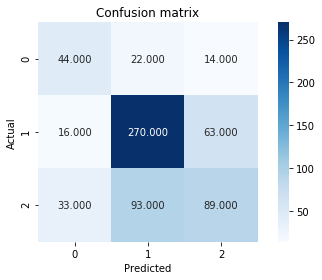

In [364]:
# K nearest neighbour with k = 4 and 5 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 45  10  25]
 [ 19 255  75]
 [ 34  81 100]]
0.6211180124223602
0.3788819875776398
[0.45918367 0.73699422 0.5       ]
[0.5625     0.73065903 0.46511628]
[0.50561798 0.73381295 0.48192771]


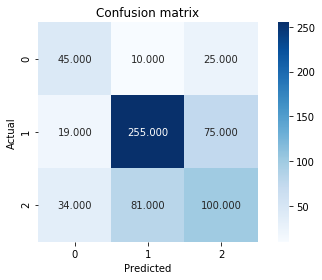

In [365]:
# K nearest neighbour with k = 4 and 5 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 41  17  22]
 [ 23 281  45]
 [ 32 104  79]]
0.6226708074534162
0.3773291925465838
[0.42708333 0.69900498 0.54109589]
[0.5125     0.80515759 0.36744186]
[0.46590909 0.74833555 0.43767313]


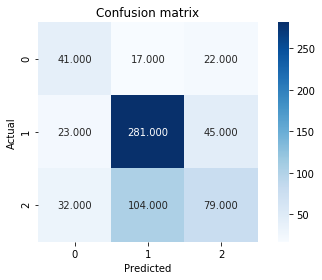

In [366]:
# K nearest neighbour with k = 4 and 5 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Median Household Income"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Median Household Income"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 40  22  18]
 [ 10 294  45]
 [ 26 134  55]]
0.6040372670807453
0.39596273291925466
[0.52631579 0.65333333 0.46610169]
[0.5        0.84240688 0.25581395]
[0.51282051 0.7359199  0.33033033]


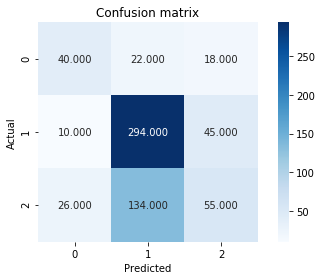

In [367]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [368]:
# k = 4, 5 parameter
# 0.73469388 0.48241206 0.47741935
# 0.73170732 0.51141553 0.50980392		"TotalPop","Poverty", "Men", 'Black', 'Citizen Voting Age Pop'
# 0.7483531  0.45144357 0.43243243
# 0.73134328 0.36931818 0.48484848
# 0.74135546 0.48076923 0.46979866

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 43  24  13]
 [ 16 265  68]
 [ 34  93  88]]
0.6149068322981367
0.3850931677018633
[0.46236559 0.69371728 0.52071006]
[0.5375     0.75931232 0.40930233]
[0.49710983 0.7250342  0.45833333]


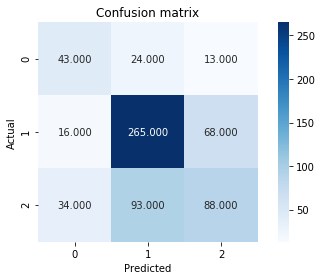

In [369]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","White"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","White"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 41  17  22]
 [ 22 283  44]
 [ 32 108  75]]
0.6195652173913043
0.3804347826086957
[0.43157895 0.69362745 0.53191489]
[0.5125     0.81088825 0.34883721]
[0.46857143 0.74768824 0.42134831]


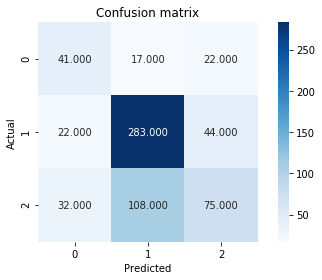

In [370]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","Median Household Income"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","Median Household Income"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 39  21  20]
 [ 10 298  41]
 [ 26 129  60]]
0.6164596273291926
0.38354037267080743
[0.52       0.66517857 0.49586777]
[0.4875     0.85386819 0.27906977]
[0.50322581 0.74780427 0.35714286]


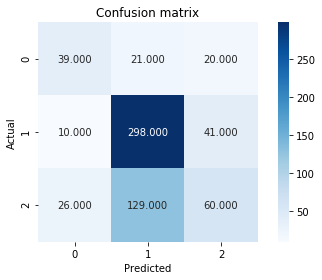

In [371]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","IncomePerCap"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","IncomePerCap"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 42  12  26]
 [ 14 276  59]
 [ 37  88  90]]
0.6335403726708074
0.36645962732919257
[0.4516129  0.73404255 0.51428571]
[0.525      0.79083095 0.41860465]
[0.48554913 0.76137931 0.46153846]


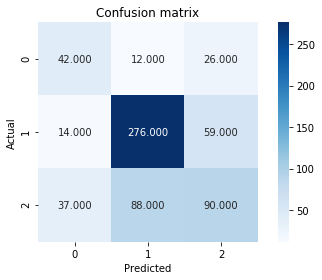

In [372]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","ChildPoverty"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black", "Citizen Voting Age Pop","ChildPoverty"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [373]:
# k = 4, 6 parameter
# 0.72305593 0.47761194 0.47058824
# 0.74934726 0.44385027 0.45945946
# 0.74406991 0.38068182 0.45925926
# 0.75720165 0.5        0.47619048

# 0.73170732 0.51141553 0.50980392		"TotalPop","Poverty", "Men", 'Black', 'Citizen Voting Age Pop'
# All Values beginn to decreace.


C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 67   2  11]
 [  4 283  62]
 [ 45  28 142]]
0.7639751552795031
0.2360248447204969
[0.57758621 0.90415335 0.66046512]
[0.8375     0.81088825 0.66046512]
[0.68367347 0.85498489 0.66046512]


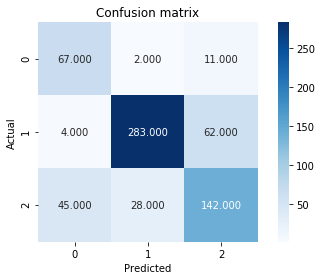

In [374]:
# K nearest neighbour with k = 4 and 6 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 66   2  12]
 [  5 295  49]
 [ 47  25 143]]
0.782608695652174
0.21739130434782605
[0.55932203 0.91614907 0.70098039]
[0.825      0.84527221 0.66511628]
[0.66666667 0.87928465 0.68257757]


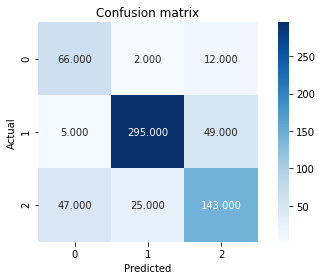

In [375]:
# K nearest neighbour with k = 4 and 7 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
             'Percent Population with age between 16 and 44']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
                'Percent Population with age between 16 and 44']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  import sys


[[ 68   5   7]
 [  7 297  45]
 [ 60  45 110]]
0.7375776397515528
0.26242236024844723
[0.5037037  0.85590778 0.67901235]
[0.85       0.85100287 0.51162791]
[0.63255814 0.85344828 0.58355438]


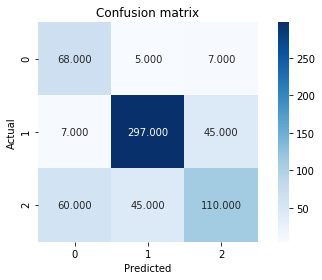

In [376]:
# K nearest neighbour with k = 4 and 8 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 
             'Percent Population with age between 45 and 74']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
                  'Percent Population with age between 16 and 44', 
                'Percent Population with age between 45 and 74']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  import sys


[[ 67   2  11]
 [  5 299  45]
 [ 45  40 130]]
0.7701863354037267
0.22981366459627328
[0.57264957 0.87683284 0.69892473]
[0.8375     0.85673352 0.60465116]
[0.68020305 0.86666667 0.64837905]


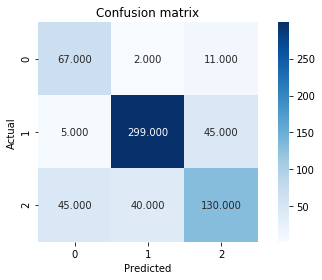

In [377]:
# K nearest neighbour with k = 4 and 8 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 
             'Percent Population with age between 75 and over']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 
                'Percent Population with age between 75 and over']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 71   1   8]
 [  3 296  50]
 [ 41  35 139]]
0.7857142857142857
0.2142857142857143
[0.6173913  0.89156627 0.70558376]
[0.8875     0.84813754 0.64651163]
[0.72820513 0.86930984 0.67475728]


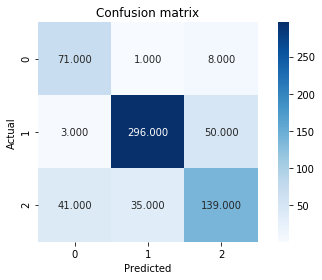

In [378]:
# K nearest neighbour with k = 4 and 8 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 71   1   8]
 [  4 299  46]
 [ 40  36 139]]
0.7903726708074534
0.20962732919254656
[0.6173913  0.88988095 0.72020725]
[0.8875     0.85673352 0.64651163]
[0.72820513 0.8729927  0.68137255]


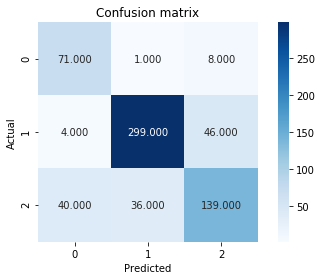

In [379]:
# K nearest neighbour with k = 4 and 9 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 68   1  11]
 [  5 296  48]
 [ 42  37 136]]
0.7763975155279503
0.22360248447204967
[0.59130435 0.88622754 0.6974359 ]
[0.85       0.84813754 0.63255814]
[0.6974359  0.86676428 0.66341463]


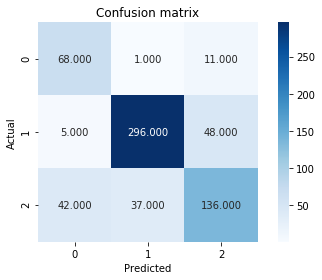

In [380]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Asian']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Asian']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 71   1   8]
 [  4 298  47]
 [ 40  37 138]]
0.7872670807453416
0.21273291925465843
[0.6173913  0.88690476 0.71502591]
[0.8875     0.85386819 0.64186047]
[0.72820513 0.87007299 0.67647059]


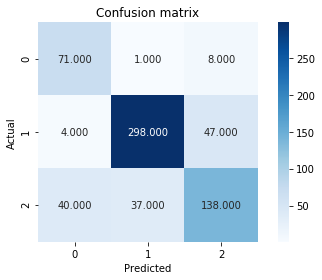

In [381]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Pacific']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Pacific']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 67   2  11]
 [  9 298  42]
 [ 43  43 129]]
0.7670807453416149
0.23291925465838514
[0.56302521 0.86880466 0.70879121]
[0.8375     0.85386819 0.6       ]
[0.67336683 0.86127168 0.64987406]


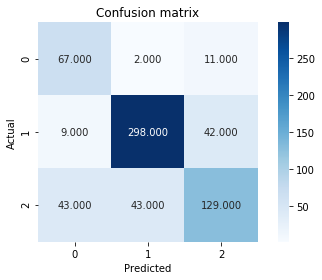

In [382]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Professional']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Professional']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 65   2  13]
 [  7 288  54]
 [ 41  45 129]]
0.7484472049689441
0.2515527950310559
[0.57522124 0.85970149 0.65816327]
[0.8125    0.8252149 0.6      ]
[0.67357513 0.84210526 0.62773723]


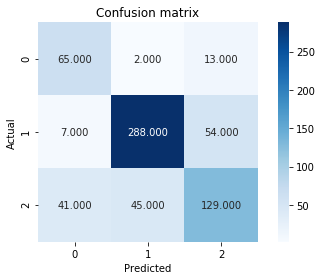

In [383]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Service']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Service']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 71   1   8]
 [  4 294  51]
 [ 44  38 133]]
0.7732919254658385
0.22670807453416153
[0.59663866 0.88288288 0.69270833]
[0.8875     0.84240688 0.61860465]
[0.71356784 0.86217009 0.65356265]


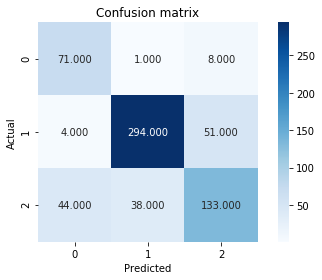

In [384]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Office']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Office']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 73   1   6]
 [  6 291  52]
 [ 48  41 126]]
0.7608695652173914
0.23913043478260865
[0.57480315 0.87387387 0.68478261]
[0.9125     0.83381089 0.58604651]
[0.70531401 0.85337243 0.63157895]


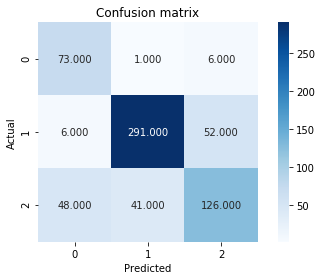

In [385]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Construction']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Construction']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 66   2  12]
 [  4 301  44]
 [ 37  59 119]]
0.7546583850931677
0.24534161490683226
[0.61682243 0.83149171 0.68      ]
[0.825      0.86246418 0.55348837]
[0.70588235 0.8466948  0.61025641]


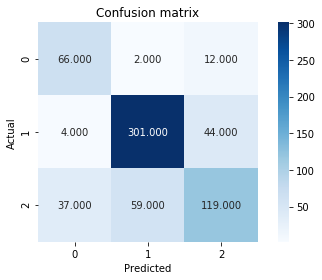

In [386]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Production']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Production']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 74   1   5]
 [  6 292  51]
 [ 44  36 135]]
0.7779503105590062
0.2220496894409938
[0.59677419 0.88753799 0.70680628]
[0.925      0.83667622 0.62790698]
[0.7254902  0.86135693 0.66502463]


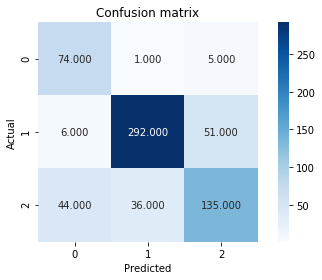

In [387]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Drive']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Drive']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 60   1  19]
 [  8 282  59]
 [ 40  52 123]]
0.7220496894409938
0.2779503105590062
[0.55555556 0.84179104 0.6119403 ]
[0.75       0.80802292 0.57209302]
[0.63829787 0.8245614  0.59134615]


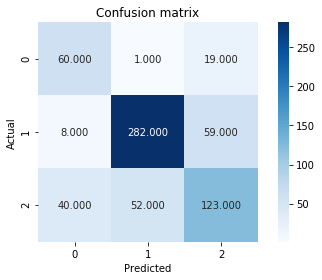

In [388]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Carpool']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Carpool']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 72   1   7]
 [  4 299  46]
 [ 42  34 139]]
0.7919254658385093
0.2080745341614907
[0.61016949 0.89520958 0.72395833]
[0.9        0.85673352 0.64651163]
[0.72727273 0.87554905 0.68304668]


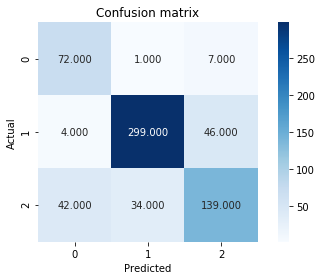

In [389]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Transit']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Transit']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 70   1   9]
 [  5 295  49]
 [ 40  42 133]]
0.7732919254658385
0.22670807453416153
[0.60869565 0.87278107 0.69633508]
[0.875      0.84527221 0.61860465]
[0.71794872 0.8588064  0.65517241]


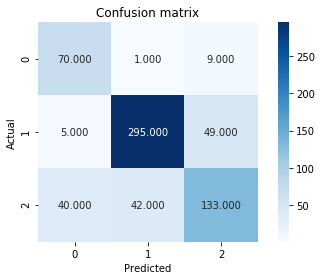

In [390]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Walk']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Walk']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 71   1   8]
 [  5 291  53]
 [ 39  41 135]]
0.7717391304347826
0.2282608695652174
[0.6173913  0.87387387 0.68877551]
[0.8875     0.83381089 0.62790698]
[0.72820513 0.85337243 0.65693431]


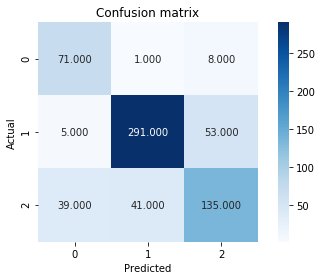

In [391]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'WorkAtHome']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'WorkAtHome']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 70   3   7]
 [  6 299  44]
 [ 46  41 128]]
0.7717391304347826
0.2282608695652174
[0.57377049 0.87172012 0.7150838 ]
[0.875      0.85673352 0.59534884]
[0.69306931 0.86416185 0.64974619]


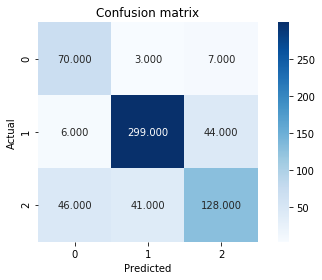

In [392]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Mean Commute Time']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'Mean Commute Time']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


[[ 66   2  12]
 [  6 296  47]
 [ 44  39 132]]
0.7670807453416149
0.23291925465838514
[0.56896552 0.87833828 0.69109948]
[0.825      0.84813754 0.61395349]
[0.67346939 0.86297376 0.65024631]


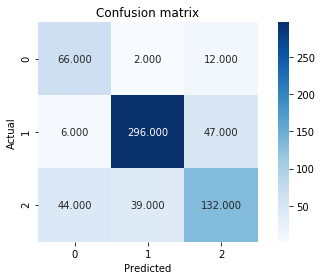

In [393]:
# K nearest neighbour with k = 4 and 10 parameter
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'State Unemployment rate for 2013']]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
               'Percent Population with age between 16 and 44', 'Hispanic', 'Native', 'State Unemployment rate for 2013']]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

C:\Users\kalya\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


[[ 69   1  10]
 [  5 272  72]
 [ 57  29 129]]
0.7298136645962733
0.2701863354037267
[0.52671756 0.90066225 0.61137441]
[0.8625     0.77936963 0.6       ]
[0.65402844 0.83563748 0.6056338 ]


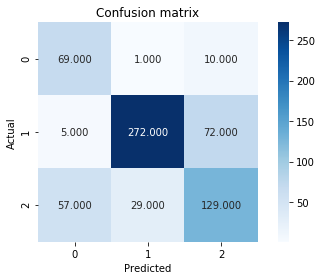

In [394]:
# K nearest neighbour with k = 4 and "County Unemployment Rate for 2013"
model = KNeighborsClassifier(n_neighbors = 4)
x = x_train[["County Unemployment Rate for 2013"]]
y = y_train
model.fit(x, y)

# Predict class labels using KNearest Neighbour
x_test = x_val[["County Unemployment Rate for 2013"]]
y_pred = model.predict(x_test)


# Compute confusion matrix
y_test = y_val
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [395]:
# In case of K_Nearest Neighbour with k=4, the classifier with 
# "TotalPop","Poverty", "Men", "Black" ,"Citizen Voting Age Pop", "County Unemployment Rate for 2013",
# 'Percent Population with age between 16 and 44', 'Hispanic', 'Native' is the best one with F1 Scores
# [0.72820513 0.8729927  0.68137255]

In [396]:
# The best classifier is 
# Naive Bayes, the classifier with parameter:
# "County Unemployment Rate for 2013"
# is the best one with F1 Scores:
# [0.7625     0.86728395 0.74166667]

In [397]:
import plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff

fips =data_new['CensusId'].astype(str).tolist()
values = data_new['Class'].tolist()
#colorscale = ['rgb(0,0,255)', 'rgb(255,0,0)', 'rgb(0,255,0)']
fig = ff.create_choropleth(fips=fips, values=values)
fig.layout.template = None
fig.show()

C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\frame.py:6692: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [398]:
# Predicting the classes of observations of 2015 data

In [399]:
scaler = MinMaxScaler(feature_range=(0, 1))
DataC[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']] = scaler.fit_transform(DataC[['TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomePerCap',
       'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office',
       'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk',
       'OtherTransp', 'WorkAtHome', 'Mean Commute Time',
       'State Unemployment rate for 2013', 'County Unemployment Rate for 2013']])

In [400]:
#DataC.info()

[[ 226   11  183]
 [   2 1594  160]
 [  28  221  795]]
0.812111801242236
0.18788819875776397
[0.8828125  0.87294633 0.69859402]
[0.53809524 0.90774487 0.76149425]
[0.66863905 0.89000558 0.72868928]


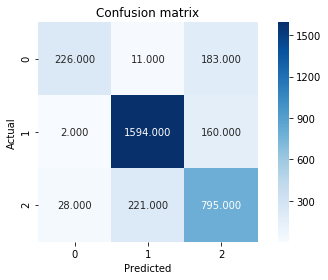

In [401]:
# Predicting the classes of observations of 2015 data


# Predict class labels using Naive Bayes
x_test = DataC[["County Unemployment Rate for 2013"]]
y_pred = Classifier.predict(x_test)


# Compute confusion matrix
y_test = DataC[["Class"]]
conf_matrix = metrics.confusion_matrix(y_test, y_pred)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score

In [402]:
fips =DataC['CensusId'].astype(str).tolist()
values = y_pred.tolist()
#colorscale = ['rgb(0,0,255)', 'rgb(255,0,0)', 'rgb(0,255,0)']
fig = ff.create_choropleth(fips=fips, values=values)
fig.layout.template = None
fig.show()

C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\frame.py:6692: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [403]:
dataN2017.columns

Index(['StateId', 'CountyId', 'State', 'County', 'TotalPop',
       'Percent Population with age between 16 and 44',
       'Percent Population with age between 45 and 74',
       'Percent Population with age between 75 and over', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Citizen Voting Age Pop', 'Median Household Income', 'IncomeErr',
       'IncomePerCap', 'IncomePerCapErr', 'Poverty', 'ChildPoverty',
       'Professional', 'Service', 'Office', 'Construction', 'Production',
       'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
       'Mean Commute Time', 'State Unemployment rate for 2015',
       'County Unemployment Rate for 2015', 'Unemployment'],
      dtype='object')

In [404]:
row_indexes=dataN2017[dataN2017['Unemployment'] >= 12].index
dataN2017.loc[row_indexes,'Class']="3"

row_indexes1=dataN2017[(dataN2017['Unemployment'] >= 8) & (dataN2017['Unemployment'] < 12)].index
dataN2017.loc[row_indexes1,'Class']="2"

row_indexes2=dataN2017[dataN2017['Unemployment'] < 8].index
dataN2017.loc[row_indexes2,'Class']="1"

In [405]:
dataN2017['Class'][dataN2017['Class'] == "1"] = "Lowest"
dataN2017['Class'][dataN2017['Class'] == "2"] = "Moderate"
dataN2017['Class'][dataN2017['Class'] == "3"] = "Highest"

In [406]:
dataN2017.head()

,StateId,CountyId,State,County,TotalPop,Percent Population with age between 16 and 44,Percent Population with age between 45 and 74,Percent Population with age between 75 and over,Men,Women,...,Carpool,Transit,Walk,OtherTransp,WorkAtHome,Mean Commute Time,State Unemployment rate for 2015,County Unemployment Rate for 2015,Unemployment,Class
0,1,1001,Alabama,Autauga County,0.005439,0.450980,0.425926,0.25,26899,28137,...,0.327645,0.001618,0.010135,1.3,0.075758,0.5175,0.421053,0.208219,5.2,Lowest
1,1,1003,Alabama,Baldwin County,0.020116,0.392157,0.500000,0.35,99527,103833,...,0.259386,0.001618,0.013514,1.1,0.169697,0.5475,0.421053,0.205479,5.5,Lowest
2,1,1005,Alabama,Barbour County,0.002585,0.450980,0.462963,0.30,13976,12225,...,0.378840,0.004854,0.037162,1.7,0.039394,0.4575,0.421053,0.482192,12.4,Highest
3,1,1007,Alabama,Bibb County,0.002227,0.490196,0.444444,0.25,12251,10329,...,0.324232,0.011327,0.005068,1.7,0.045455,0.6225,0.421053,0.227397,8.2,Moderate
4,1,1009,Alabama,Blount County,0.005699,0.411765,0.481481,0.30,28490,29177,...,0.348123,0.001618,0.006757,0.4,0.063636,0.7475,0.421053,0.210959,4.9,Lowest


[[ 107    7   77]
 [   2 2282  127]
 [   4  220  394]]
0.6968944099378882
0.3031055900621118
[0.48046875 0.93702081 0.3602812 ]
[0.64397906 0.70966404 0.66343042]
[0.55033557 0.80764692 0.46697039]


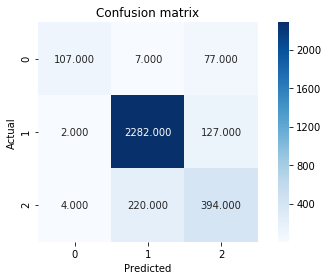

In [407]:
# Predicting the classes of observations of 2017 dataset


# Predict class labels using Naive Bayes
x_test = dataN2017[["County Unemployment Rate for 2015"]]
y_pred2 = Classifier.predict(x_test)

# Compute confusion matrix
y_test = dataN2017[["Class"]]
conf_matrix = metrics.confusion_matrix(y_test, y_pred2)
print(conf_matrix)

# Plot confusion matrix
sns.heatmap(conf_matrix, annot = True, fmt = ".3f", square = True, cmap = plt.cm.Blues)
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion matrix')
plt.tight_layout()

# Compute evaluation metrics
print(metrics.accuracy_score(y_test, y_pred)) # accuracy
print(1 - metrics.accuracy_score(y_test, y_pred)) # error
print(metrics.precision_score(y_test, y_pred, average = None)) # precision
print(metrics.recall_score(y_test, y_pred, average = None)) # recall
print(metrics.f1_score(y_test, y_pred, average = None)) # F1 score


In [408]:
fips = dataN2017['CountyId'].astype(str).tolist()
values = dataN2017["Class"].tolist()
#colorscale = ['rgb(0,0,255)', 'rgb(255,0,0)', 'rgb(0,255,0)']
fig = ff.create_choropleth(fips=fips, values=values)
fig.layout.template = None
fig.show()

C:\Users\kalya\Anaconda3\lib\site-packages\pandas\core\frame.py:6692: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [409]:
fips = dataN2017['CountyId'].astype(str).tolist()
values = y_pred2.tolist()
#colorscale = ['rgb(0,0,255)', 'rgb(255,0,0)', 'rgb(0,255,0)']
fig = ff.create_choropleth(fips=fips, values=values)
fig.layout.template = None
fig.show()

In [410]:
print(y_pred2)

['Lowest' 'Lowest' 'Highest' ... 'Highest' 'Highest' 'Highest']


In [411]:
y = pd.DataFrame(data = {"Class":y_pred2})

In [412]:
y.to_csv("Predicted Classes of counties 2017.csv")